# TA Survey Results

Download data from Qualtrics as .csv with "Use Choice Text" filled in. Requires some data cleaning prior to use. Make sure all names are correct in .csv (Firstname Lastname). Ensure no spaces at end of name.

### Import Libraries

In [1]:
import os
import numpy as np
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt

### Define Parameters

##### Notebook Configurations

In [2]:
#Turn off warnings
import warnings
warnings.filterwarnings('ignore')

#Display all columns and rows of dataframes
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

##### Paths

The paths necessary for this notebook include the working directory, data directory, output directory as well as the specific .csv file to be loaded and analyzed. If the directory structure remains unchanged, the working, data, and output folder will be automatically defined. The only path that needs to be changed is the survey_file, which should be located in the data folder.

In [3]:
#Define path to survey .csv
working_dir = Path(os.getcwd())
data_folder = working_dir / 'data'
output_folder = working_dir / 'output'

survey_file = data_folder / 'survey_results.csv'

### Load Source Data

Once downloaded from Qualtrics, the .csv file contains a variety of rows. Here, we define the rows we are interested in, i.e., the rows containing TA names and survey questions.

In [5]:
#List of columns to use; ignore others
usecols = ['TA','Q2','Q3','Q4','Q5','Q6','Q7','Q8','Q9','Q10','Q11',
               'Q12','Q13','Q14','Q15','Q16','Q17','Q18','Q19','Q20']

#Load in survey_file and specified columns
rawdata = pd.read_csv(survey_file,usecols=usecols)

#Drop metadata row, row 1 (row 0 contains column names, row 2 contains the questions)
rawdata = rawdata.drop(1)

#Replace nans/empty cells with neutral response
rawdata = rawdata.replace(np.nan, 'Neither agree nor disagree')

#Create copy of data to preserve original load-in
data = rawdata.copy(deep=True)

#Preview first 3 rows
data.head(3)

,TA,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11,Q12,Q13,Q14,Q15,Q16,Q17,Q18,Q19,Q20
0,Who is your Geology 101 Laboratory TA?(Note: T...,I attend lab regularly.,I am interested in the topics covered in lab.,I feel like I am learning the materials covere...,I understand the content in the lab manual.,The materials covered in lab reflect topics co...,The lab TA is well-prepared for lab.,The lab TA uses lab time effectively.,The lab TA clearly explains the material befor...,The lab TA effectively organizes and facilitat...,The lab TA is an effective teacher.,I feel respected by the TA.,I feel respected by the other students in the ...,I feel comfortable asking the lab TA questions.,The TA provides helpful feedback.,The lab TA grades assignments in a timely manner.,The lab TA is accessible outside of lab for ad...,The lab TA cares about the students in the class.,The lab TA cares about successful course compl...,"If given the opportunity, I would enroll in a ..."
2,TA01,Strongly agree,Neither agree nor disagree,Somewhat agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Somewhat agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree
3,TA02,Strongly agree,Somewhat disagree,Somewhat agree,Somewhat agree,Somewhat disagree,Strongly agree,Strongly agree,Somewhat agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Strongly agree,Somewhat agree,Neither agree nor disagree,Strongly agree,Neither agree nor disagree,Neither agree nor disagree


### Clean Data

To make the data numeric, we need to define the list of possible written answers and relate those in some way to numerical values. ORDER MATTERS IN THE answers AND num_answers VARIABLES! For instance, 'Strongly disagree' corresponds to the value -2, so they are both in the same position in their respective lists.

In [6]:
#List of string responses, corresponding to numerical responses
answers = ['Strongly disagree','Somewhat disagree','Neither agree nor disagree','Somewhat agree','Strongly agree']

#List of numerical responses
num_answers = [-2,-1,0,1,2]

#Replace string responses with numeric responses; zipping the lists keeps the written and numeric answers related 
for answer,number in zip(answers,num_answers):
    data = data.replace(answer,number)

Now we need to get a list of the TAs by name and make sure there are no duplicates or misspellings. If a misspelling is found, unfortunately, this needs to be adjusted manually in the .csv file.

In [11]:
#Initiate list of TA names
ta_first = [] 

#Add column description; we want to isolate the TA's first name
ta_first.append('TA first name')

#For every TA name entry... excluding the row detailing the questions
for x in data['TA'][1:]:
        
    #Isolate the first name
    x = x.split(' ')[0]
        
    #Add first name to TA name list
    ta_first.append(x)
        
#Create TA first name column and fill with ta_first list
data['TA_first'] = ta_first

#Create new dataframe sorted by TA first name values
data_sorted = data[1:].sort_values('TA_first')

#Delete original TA column, as we no longer need it
del data_sorted['TA']

#Take a peek at the data frame
data_sorted.head(3)

,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11,Q12,Q13,Q14,Q15,Q16,Q17,Q18,Q19,Q20,TA_first
2,2,0,1,2,2,2,2,2,2,2,2,1,2,2,2,2,2,2,2,TA01
66,2,-1,1,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,TA01
34,2,-1,-1,0,1,-1,1,-1,0,-2,0,2,-2,-2,-1,0,-1,-1,-2,TA01


In [12]:
#Get a list of unique TA first names (should be one entry for each TA)
tas = list(data_sorted['TA_first'].unique())

#Create dataframe containing ONLY questions
qs = data.iloc[0:1,:]

#Create dataframe containing ONLY answers
qdata = data.iloc[1:,1:]

#Create series containing unique values by column (question)
rs = pd.Series({c: qdata[c].unique() for c in qdata})

#Initate & fill list storing the amount of unique values by question
qlen = []
for x in rs:
    qlen.append(len(x))

### Visualizations

##### Number of Responses By TA

Although the example data here has a relatively uniform response rate per TA, this is not always the case. Here, we explicitly state the number of responses each TA received for context.

In [16]:
for ta in tas:
    x = data[data['TA_first']==ta].shape[0]
    print(f"{ta} received {x} responses.")

TA01 received 10 responses.
TA02 received 10 responses.
TA03 received 10 responses.
TA04 received 10 responses.
TA05 received 10 responses.
TA06 received 9 responses.
TA07 received 9 responses.
TA08 received 9 responses.
TA09 received 9 responses.
TA10 received 9 responses.
TA11 received 9 responses.
TA12 received 9 responses.
TA13 received 9 responses.
TA14 received 9 responses.
TA15 received 9 responses.
TA16 received 9 responses.


##### Question Bar Graphs

The bar graphs visualize the overall tone of all submitted responses. Responses are grouped, however, by TA and plotted on a stacked bar plot for differentiation.

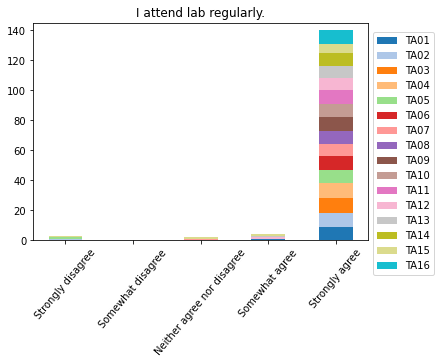

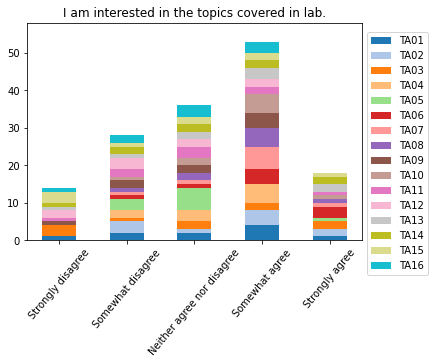

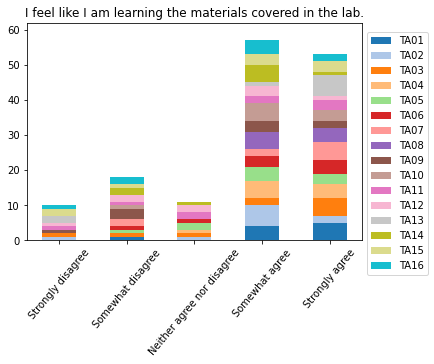

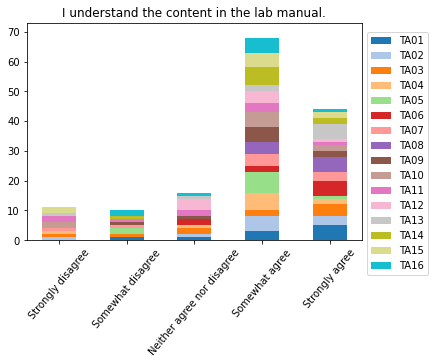

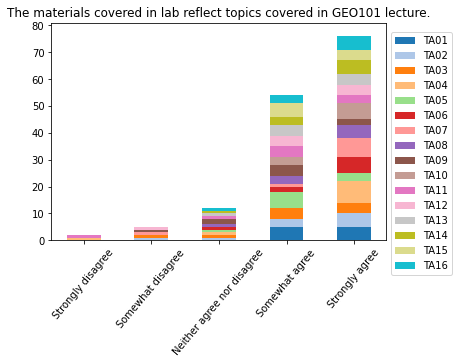

...

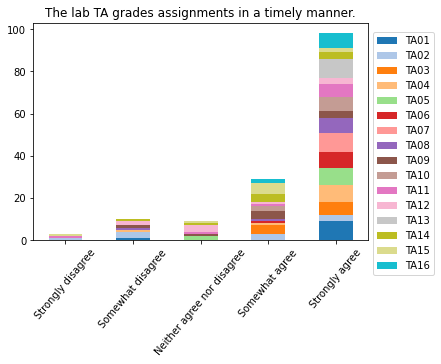

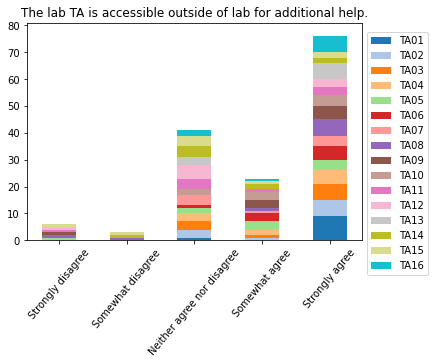

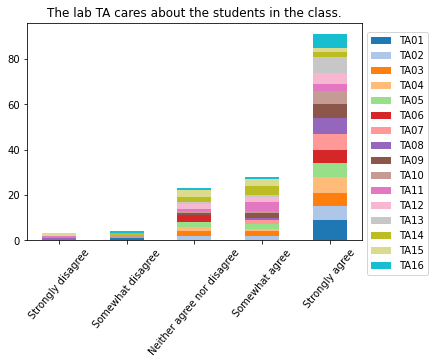

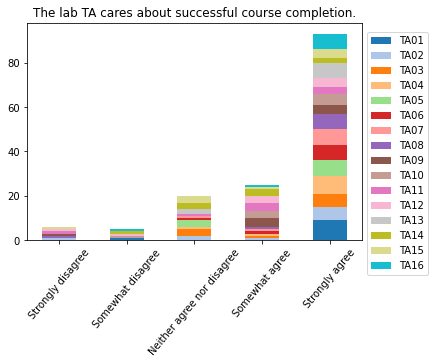

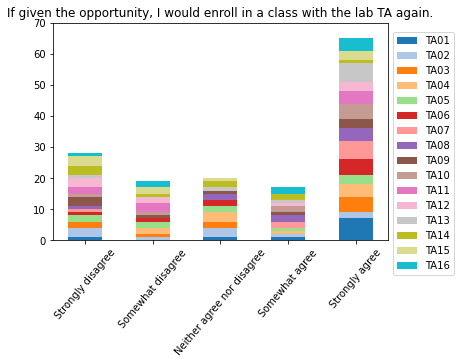

In [22]:
#Specify color map; tab20 due to distinct colors
cm = plt.get_cmap('tab20')

#Define how many numbers we are going to need (one for each ta)
NUM_COLORS = len(np.unique(qdata['TA_first']))

#Create list of labels (numeric responses)
labels_data = list(range(-2,3))

#For every question column... except TA_first...
for i,col in enumerate(qdata.columns[:-1]):
    
    #Create list of 5 zeros (to use as counters for responses)
    lst = [0]*5
    
    #Create subplot
    fig, ax = plt.subplots()
    
    #Assign color to each ta
    ax.set_prop_cycle('color', [cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)])
    
    #For every ta...
    for t, ta in enumerate(tas):
        
        #Create numeric response counter for a ta
        plot_data = [0]*5
        
        #Get dataframe with only data for specific ta
        df = data_sorted[qdata['TA_first'] == ta]
        
        #Get labels and counts of responses
        labels,counts = np.unique(df[col], return_counts=True)

        #For every label...
        for i,label in enumerate(labels):
            
            #Add corresponding count
            plot_data[label+2] += counts[i]
        
        #Plot bar plot
        plt.bar(labels_data,plot_data,label=ta,width=0.5,bottom=lst)
        
        #For every label...
        for i,label in enumerate(labels):
            
            #Stack counts on top of each other
            lst[label+2] += counts[i]

    #Set title (question)
    plt.title(qs[col][0])
    #Set limits
    plt.ylim(0,max(lst)+5)
    #Set x tick positions and labels
    plt.xticks(ticks=num_answers,labels=answers)
    #Show legend
    plt.legend(bbox_to_anchor=(1,0.4),loc='center left')
    #Rotate x ticks
    plt.xticks(rotation=50)
    
    #Save plot to output folder; name by plot type (bar) and question number (Q#)
    plt.savefig(output_folder / f'bar_{col}', pad_inches=0.3, transparent=False,
                dpi=300, bbox_inches='tight', facecolor='white')
    
    #Show plot
    plt.show()
    

##### Pie Charts (by Question and TA)

In [20]:
#Add TA_first column into original dataframe
rawdata['TA_first'] = data['TA_first']

In [21]:
#Assign colors correlating to nature of response (bad, badish, neutral, good, gooder) (hehe)
colors = ['red','orange','white','yellow','green']

#Create a dictionary of colors and correlate them to responses
colors_dict = {}

#For every color and answer combination...
for c,a in zip(colors,answers):
    
    #Answer A returns color C
    colors_dict[a] = c

First we plot pie charts by question. For every question, each TA receives one pie plot indicating the distribution of responses for each question. Colors still correspond to the tone of the response (red = very bad, orange = bad, white = neutral, etc.). This is most useful for the head TA or lab coordinator.

I attend lab regularly.


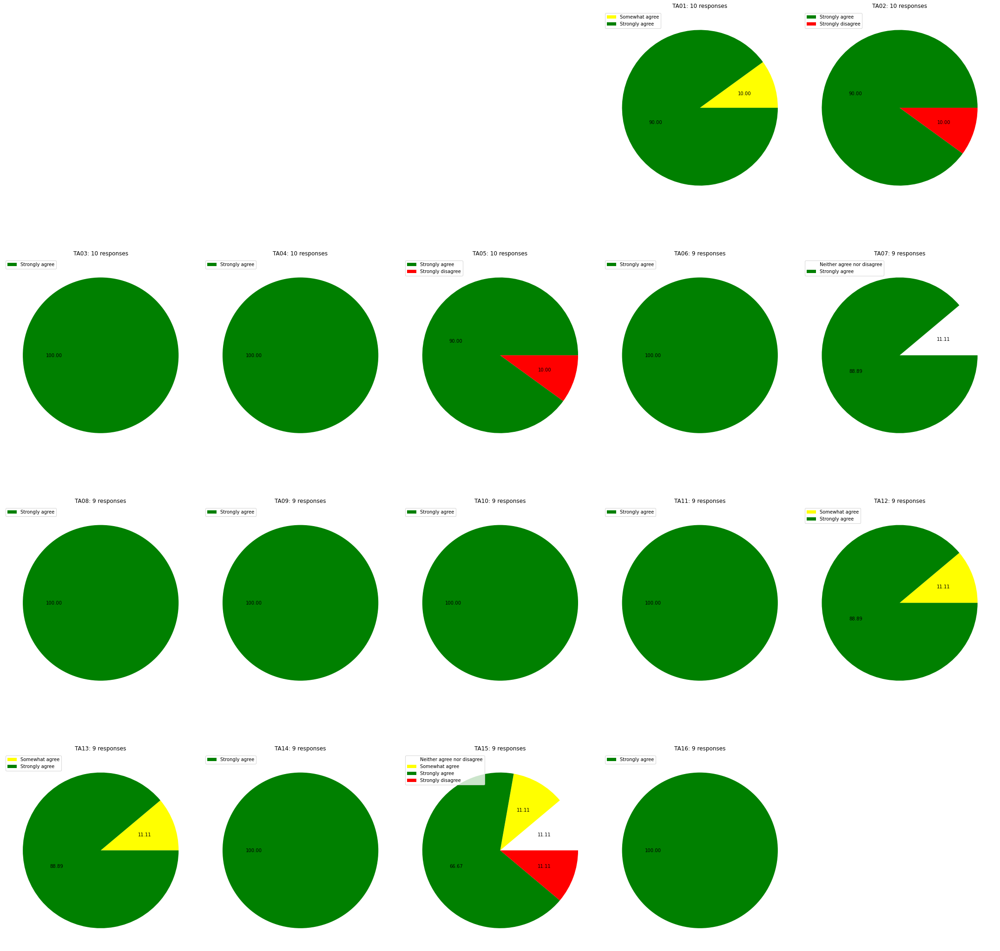

I am interested in the topics covered in lab.


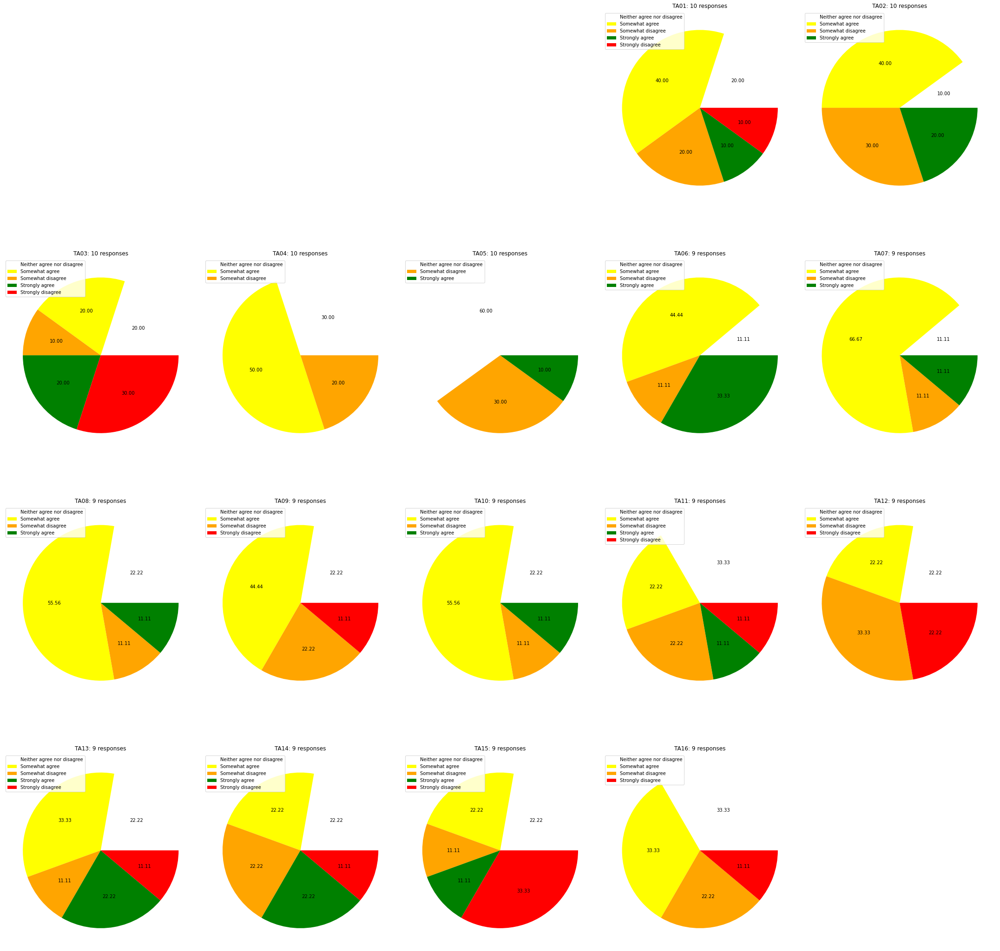

I feel like I am learning the materials covered in the lab.


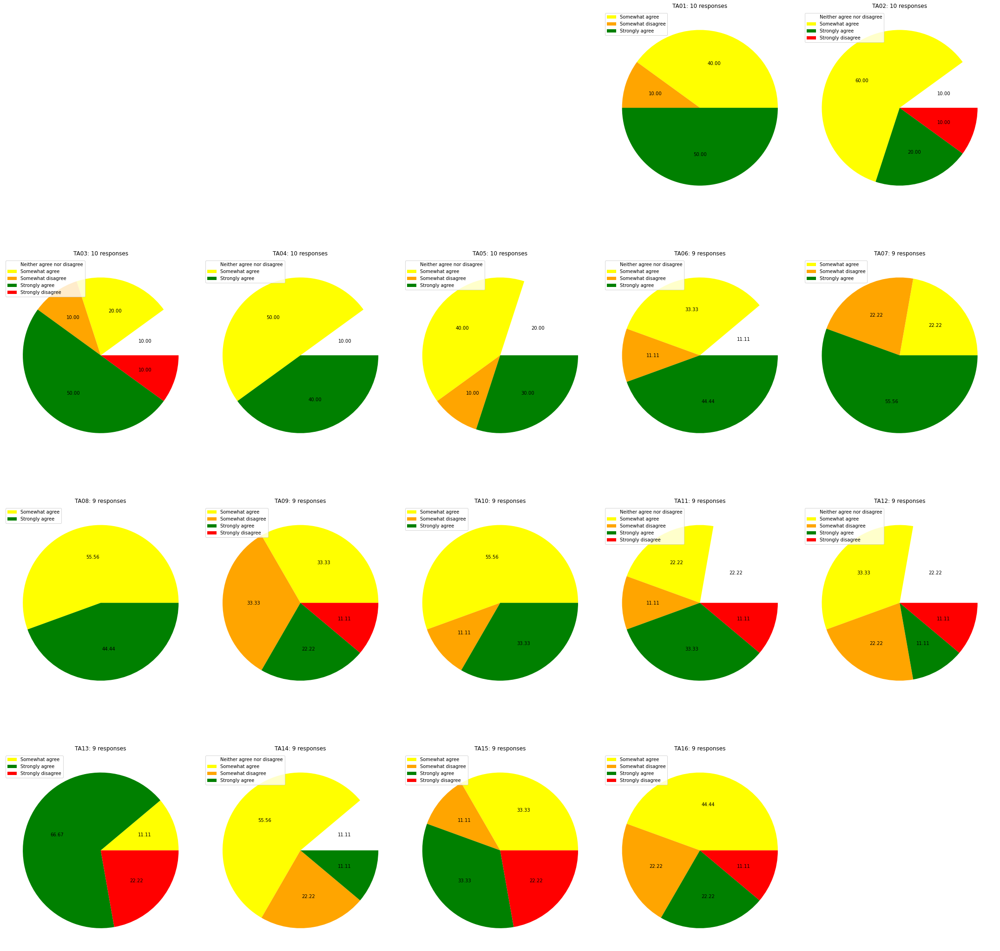

I understand the content in the lab manual.


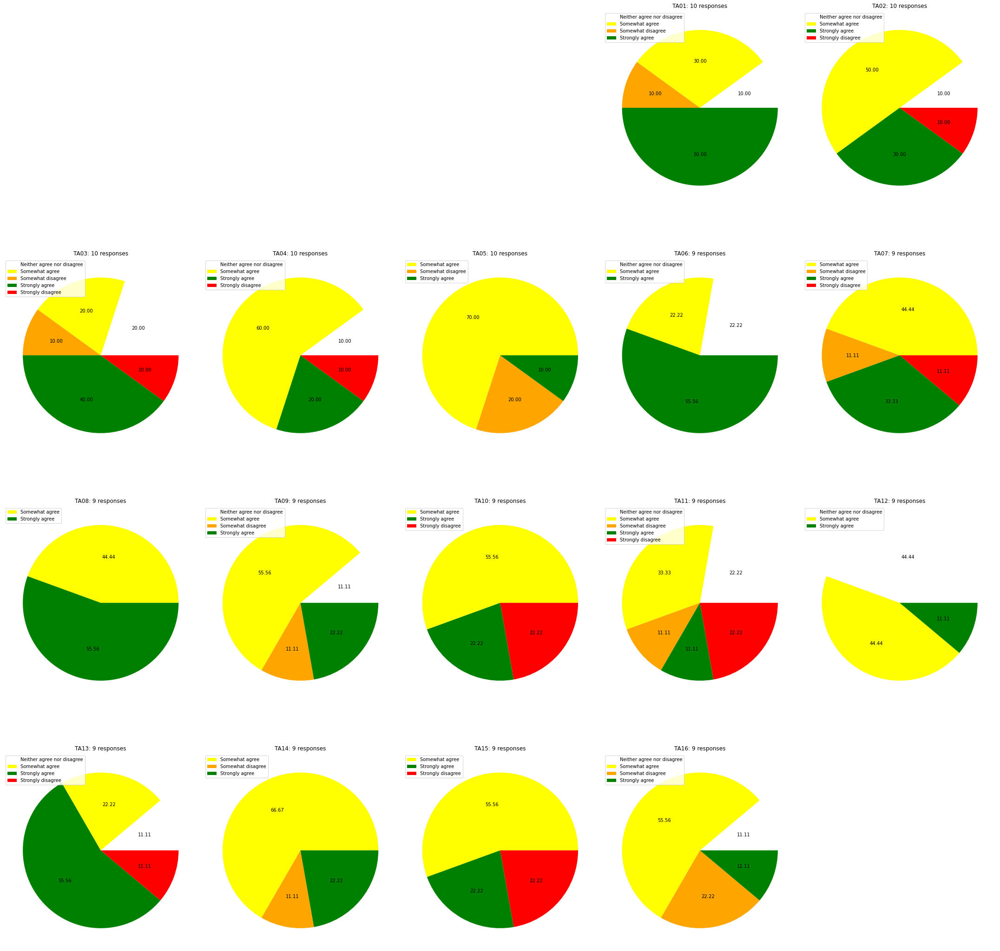

The materials covered in lab reflect topics covered in GEO101 lecture.


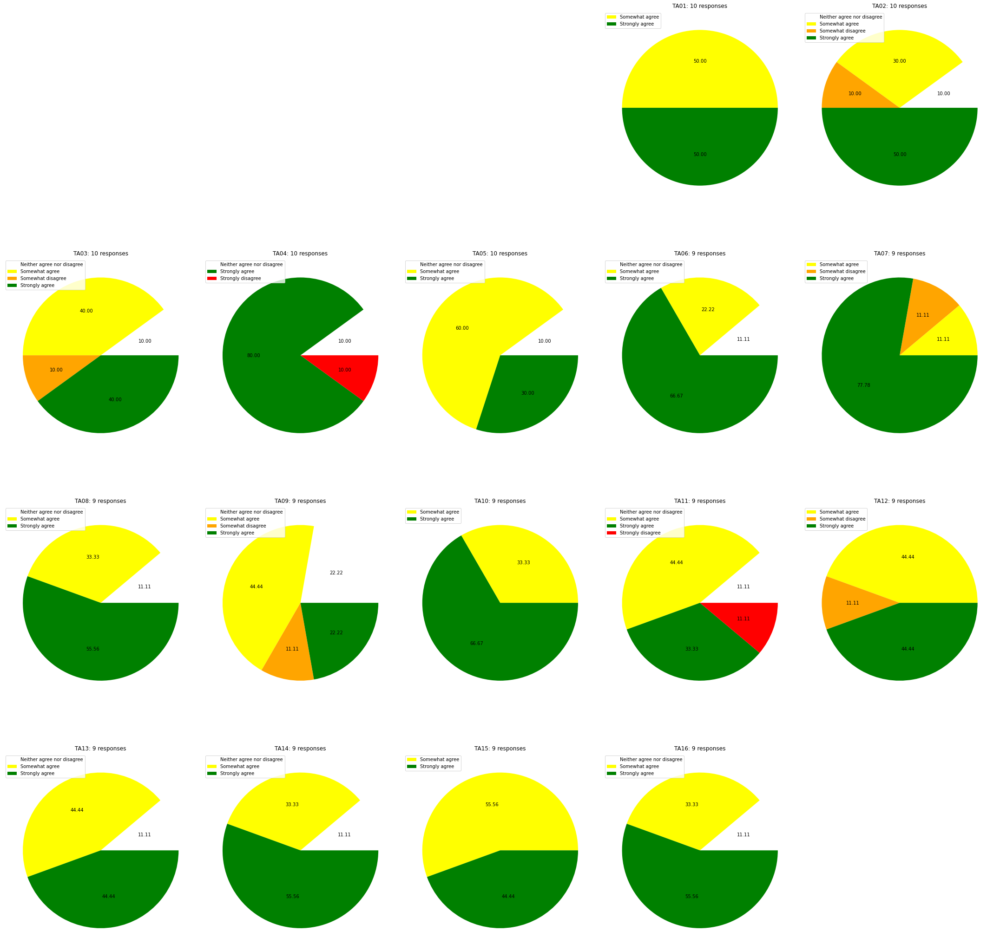

The lab TA is well-prepared for lab.


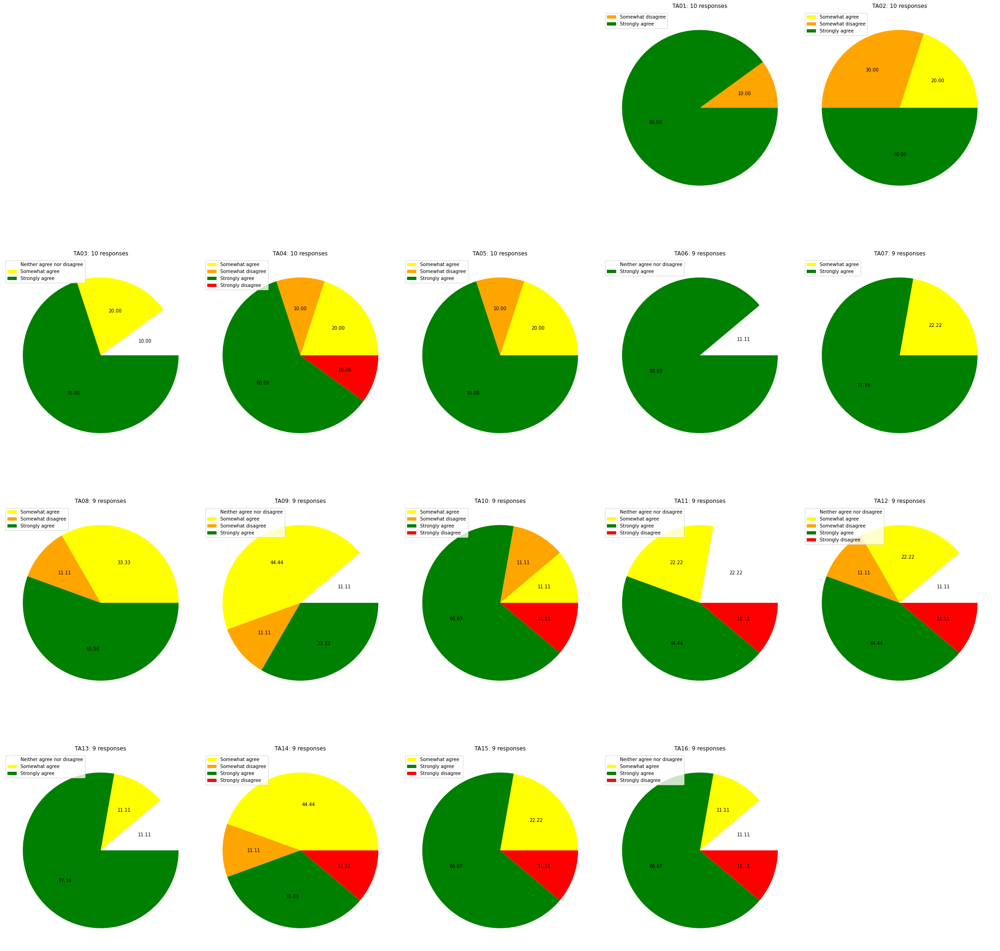

The lab TA uses lab time effectively.


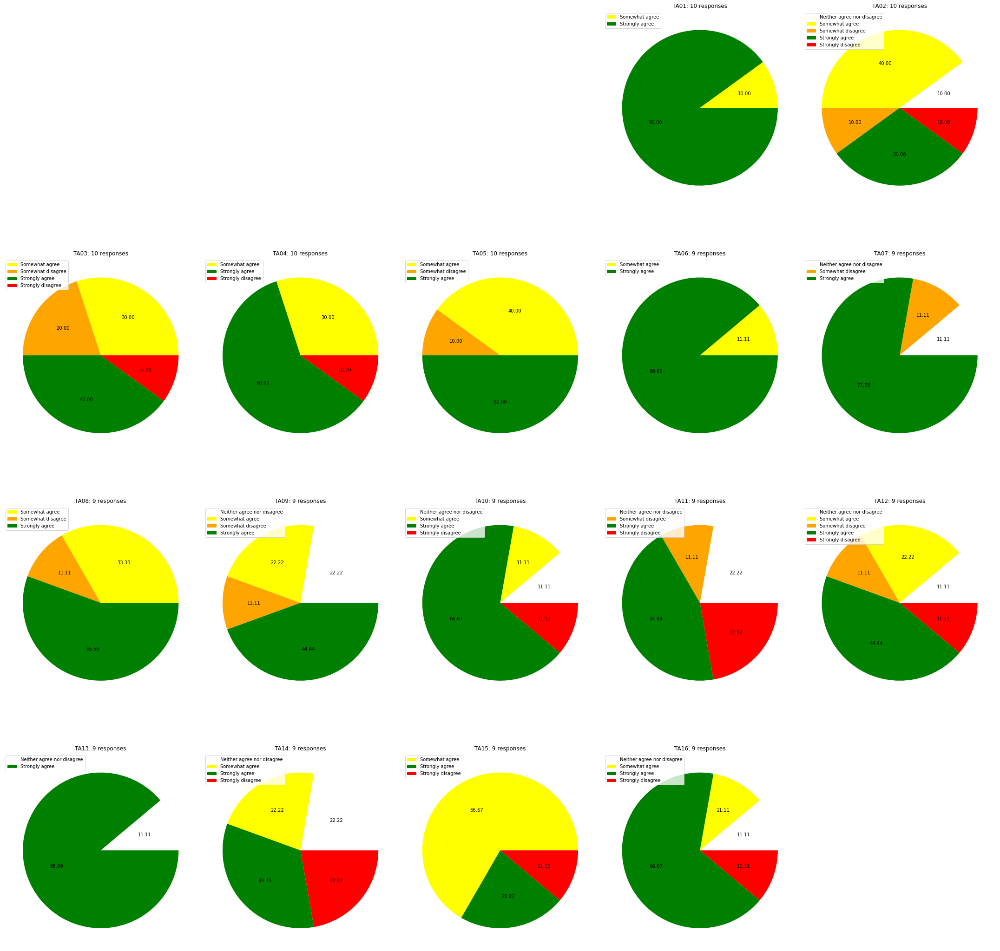

The lab TA clearly explains the material before we begin the lab.


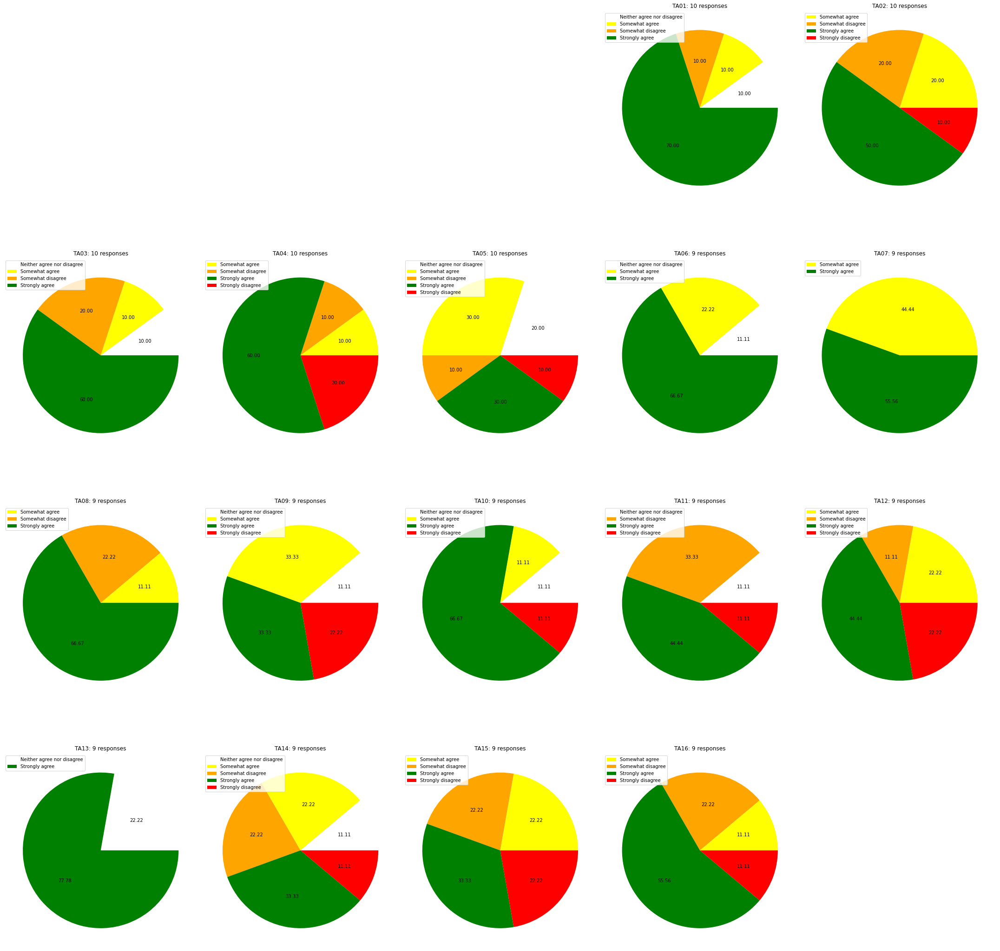

The lab TA effectively organizes and facilitates the lab.


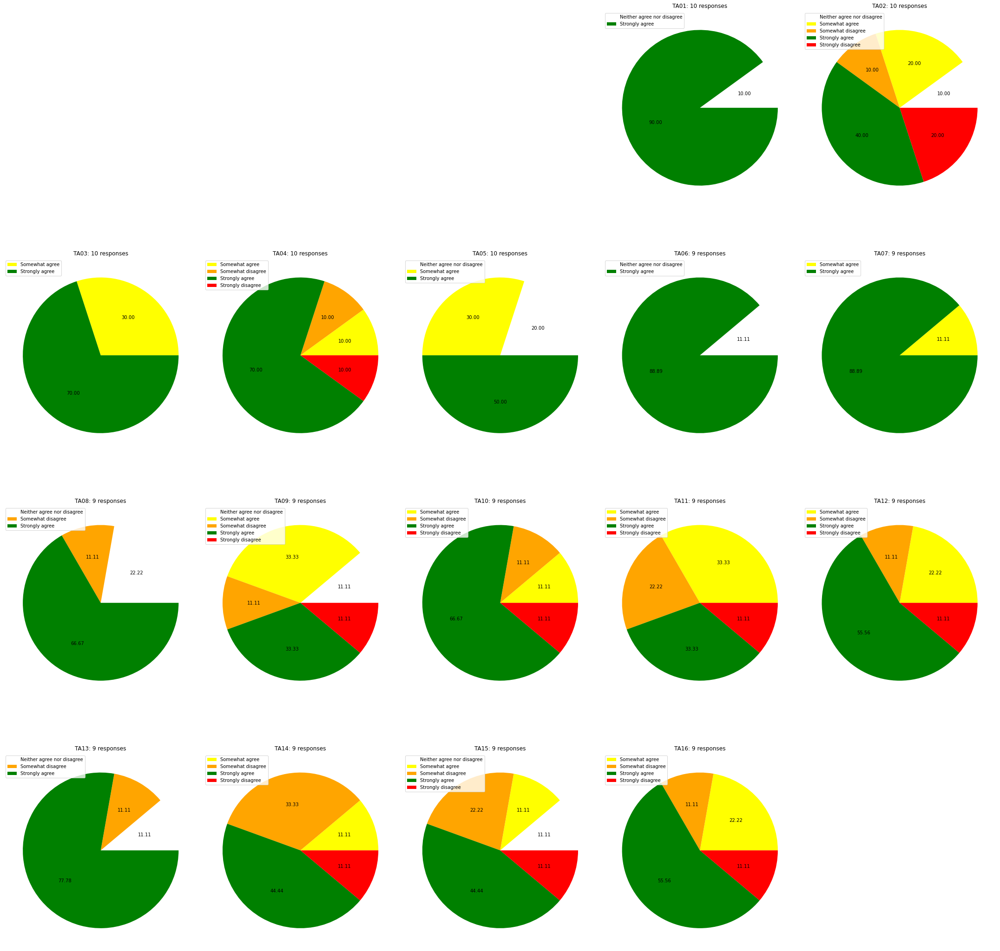

The lab TA is an effective teacher.


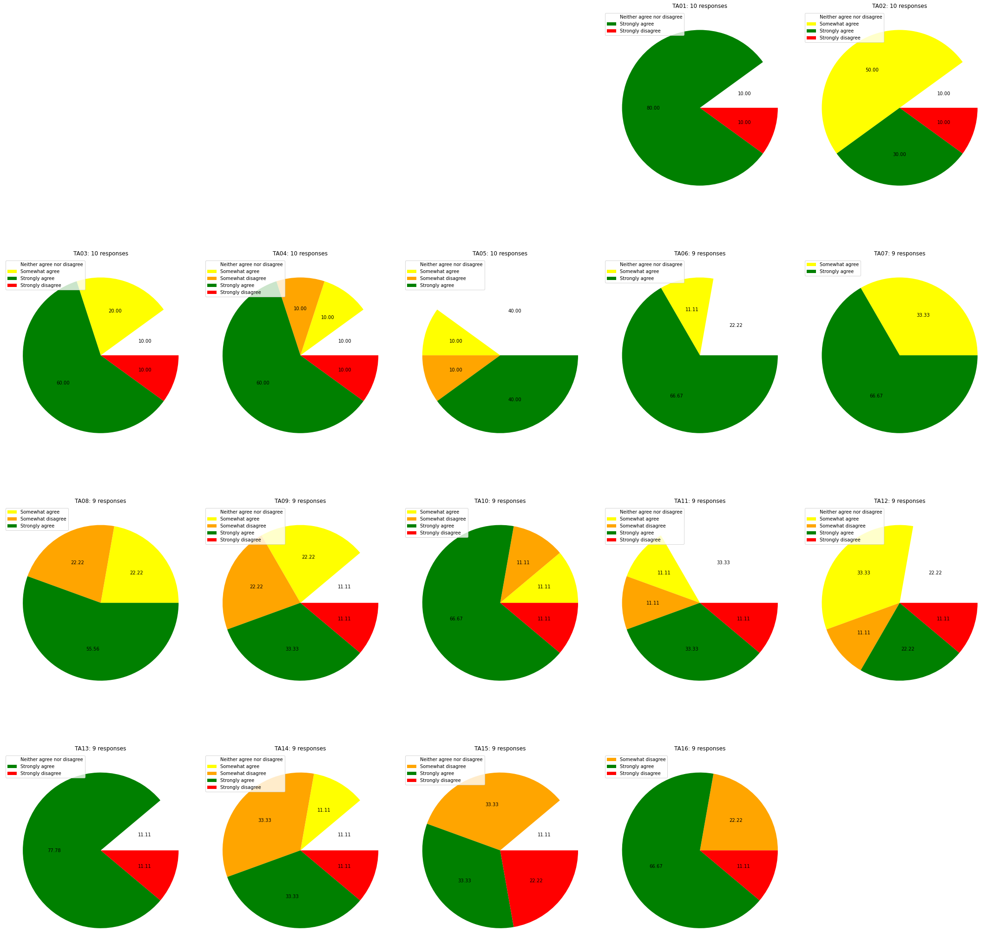

I feel respected by the TA.


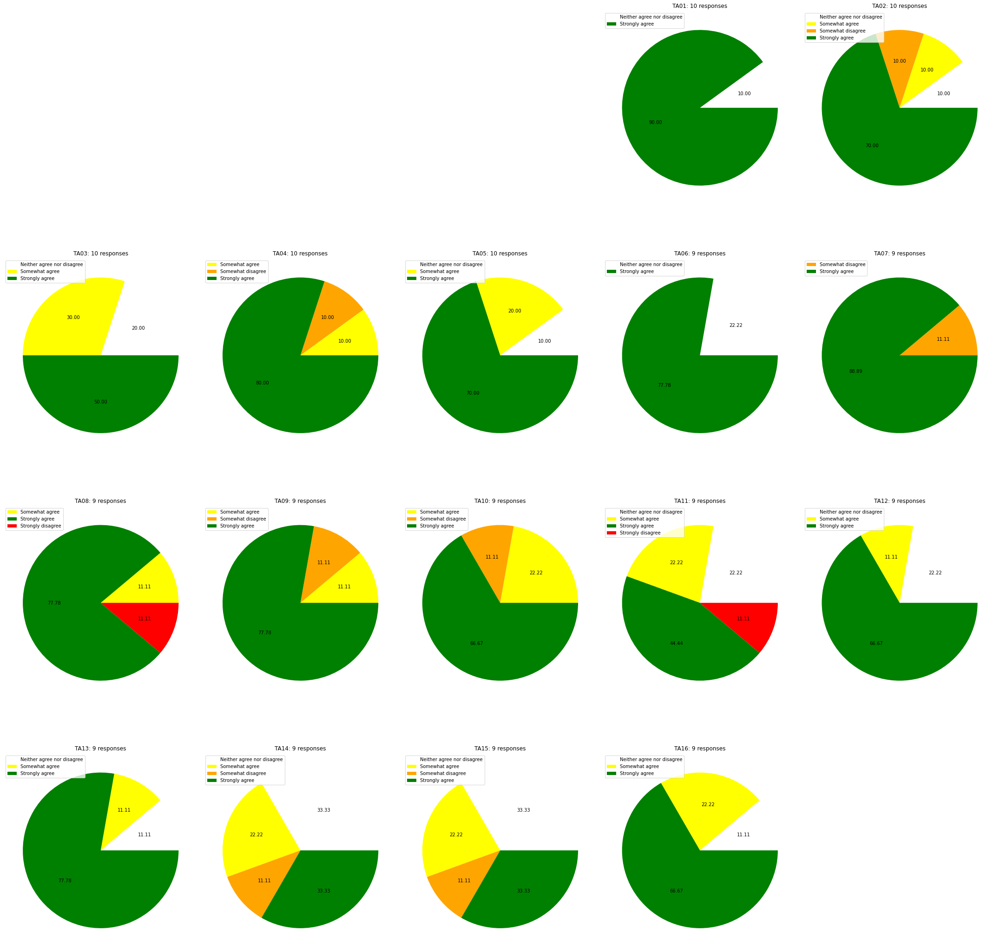

I feel respected by the other students in the lab.


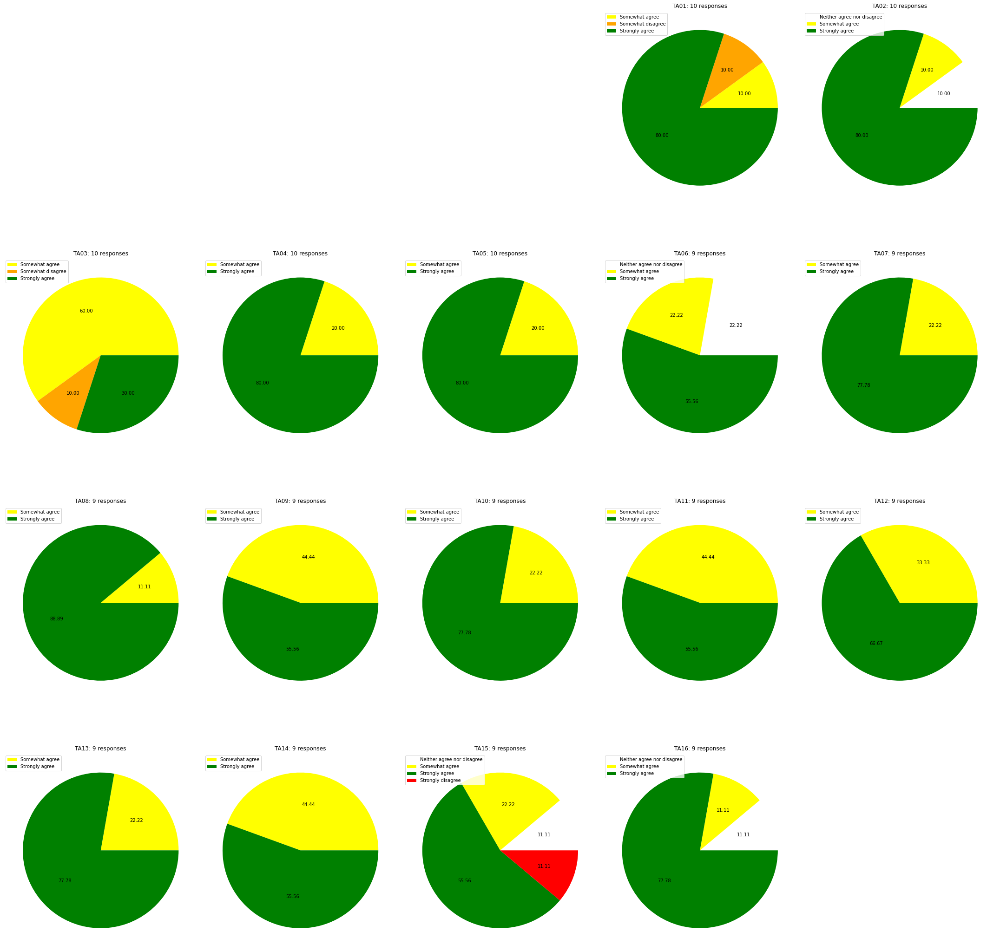

I feel comfortable asking the lab TA questions.


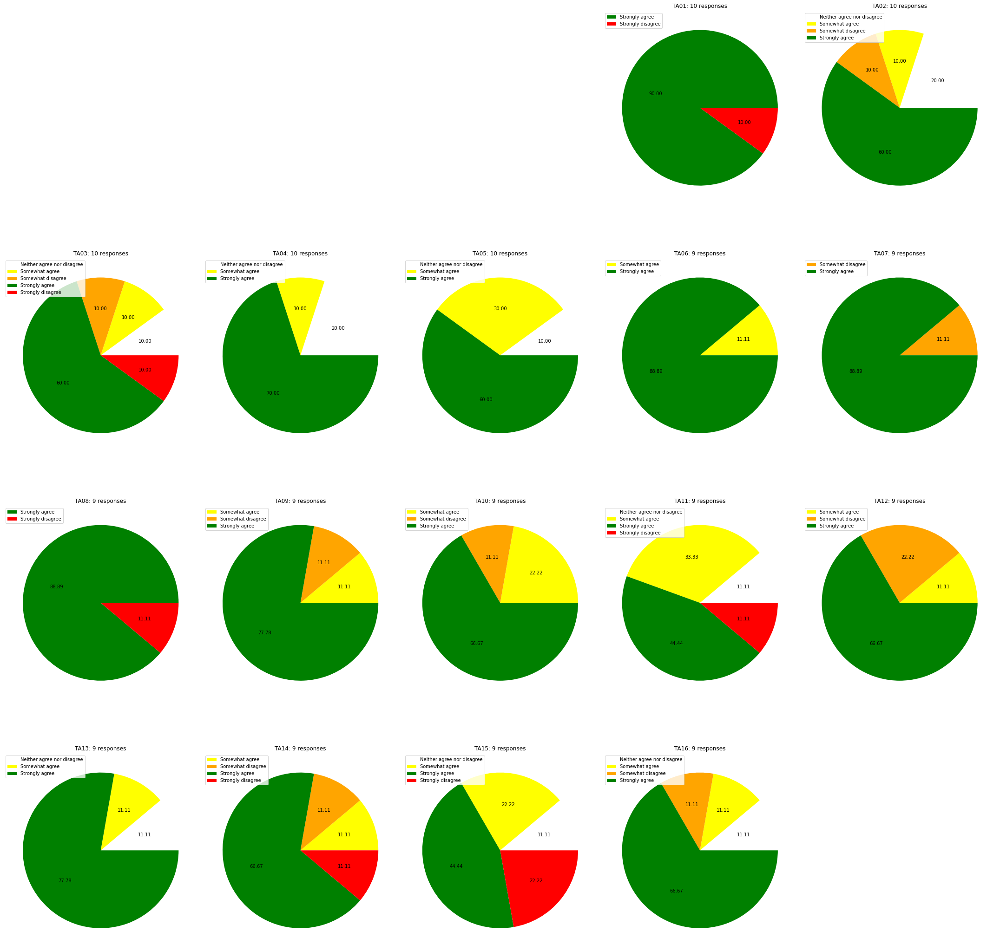

The TA provides helpful feedback.


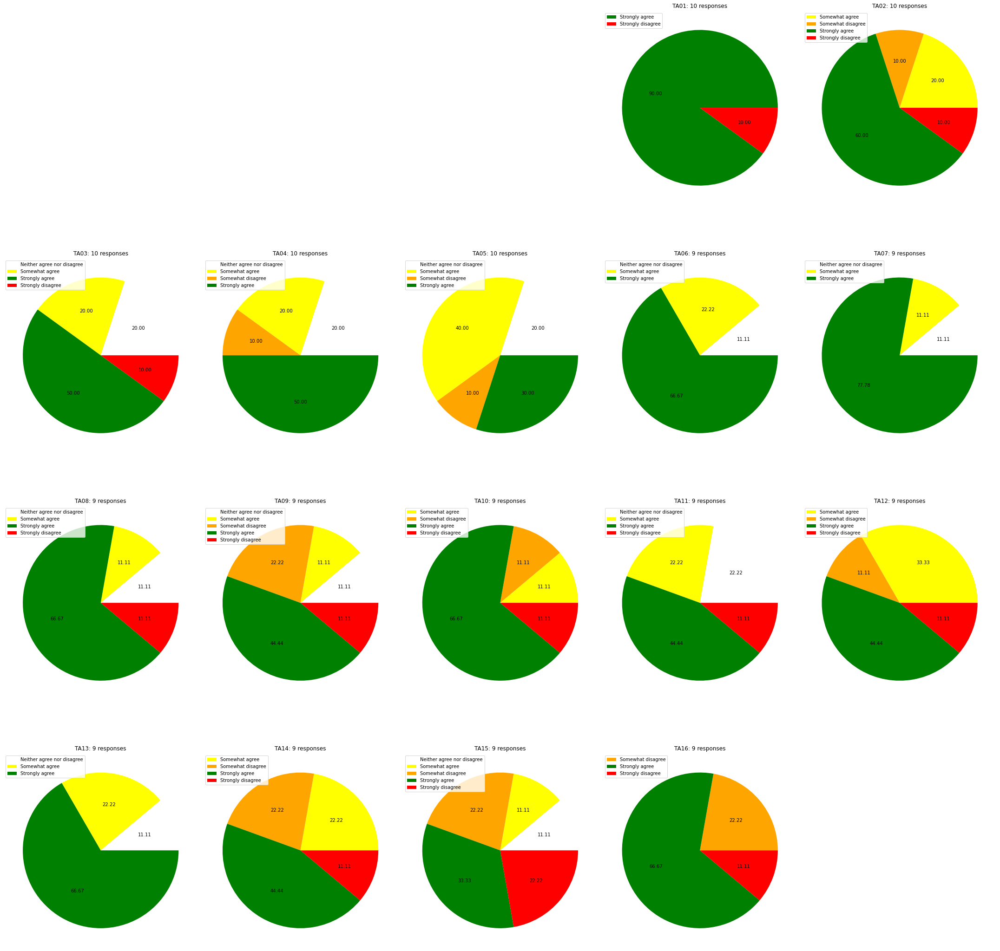

The lab TA grades assignments in a timely manner.


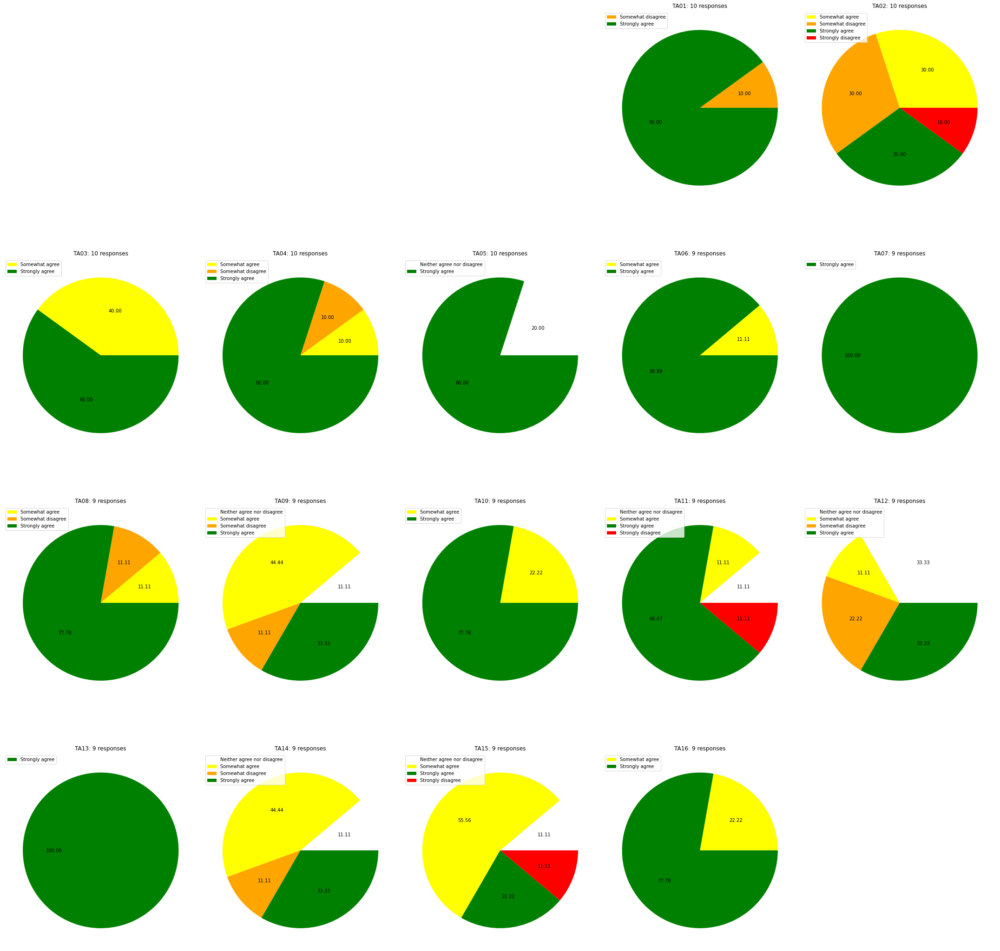

The lab TA is accessible outside of lab for additional help.


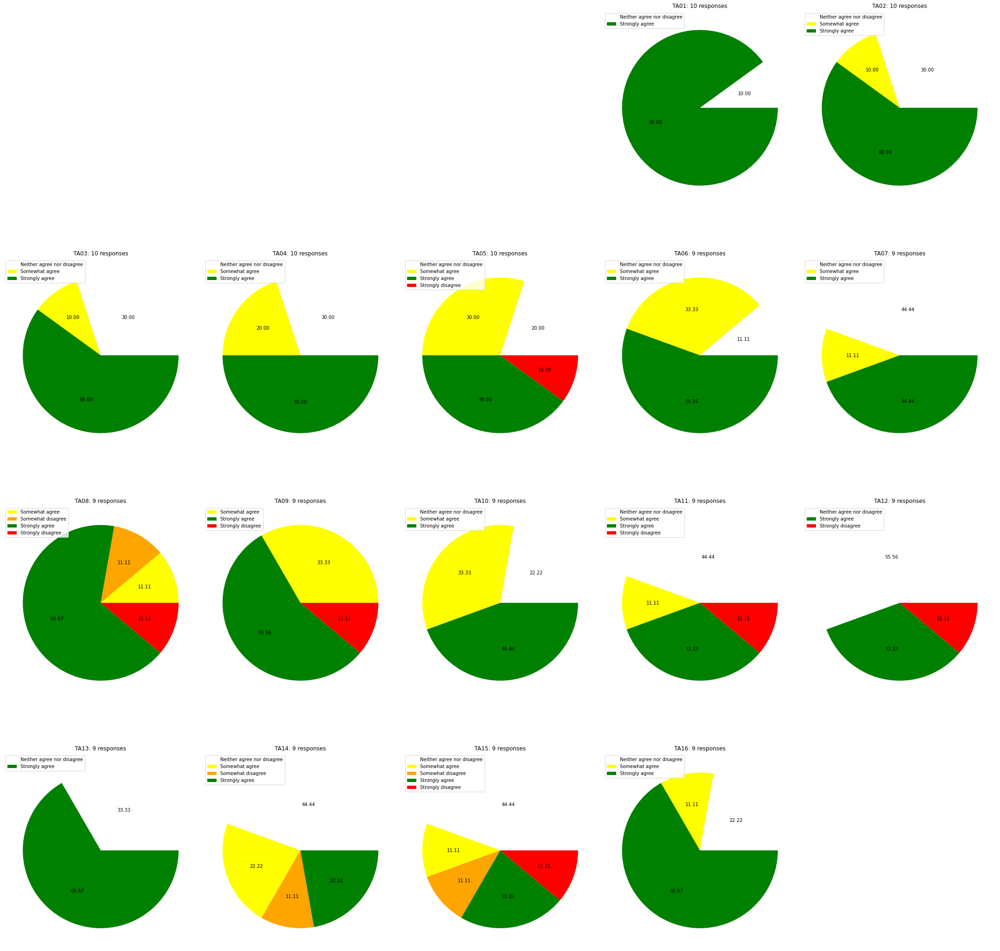

The lab TA cares about the students in the class.


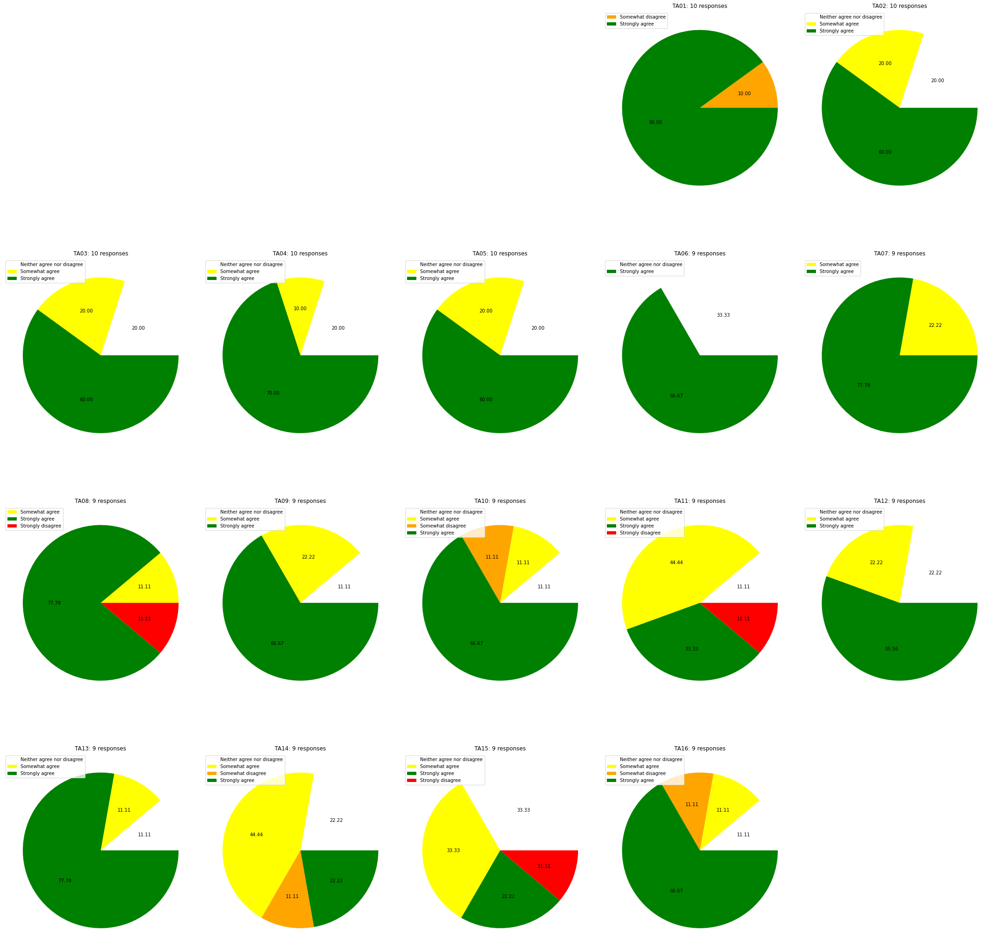

The lab TA cares about successful course completion.


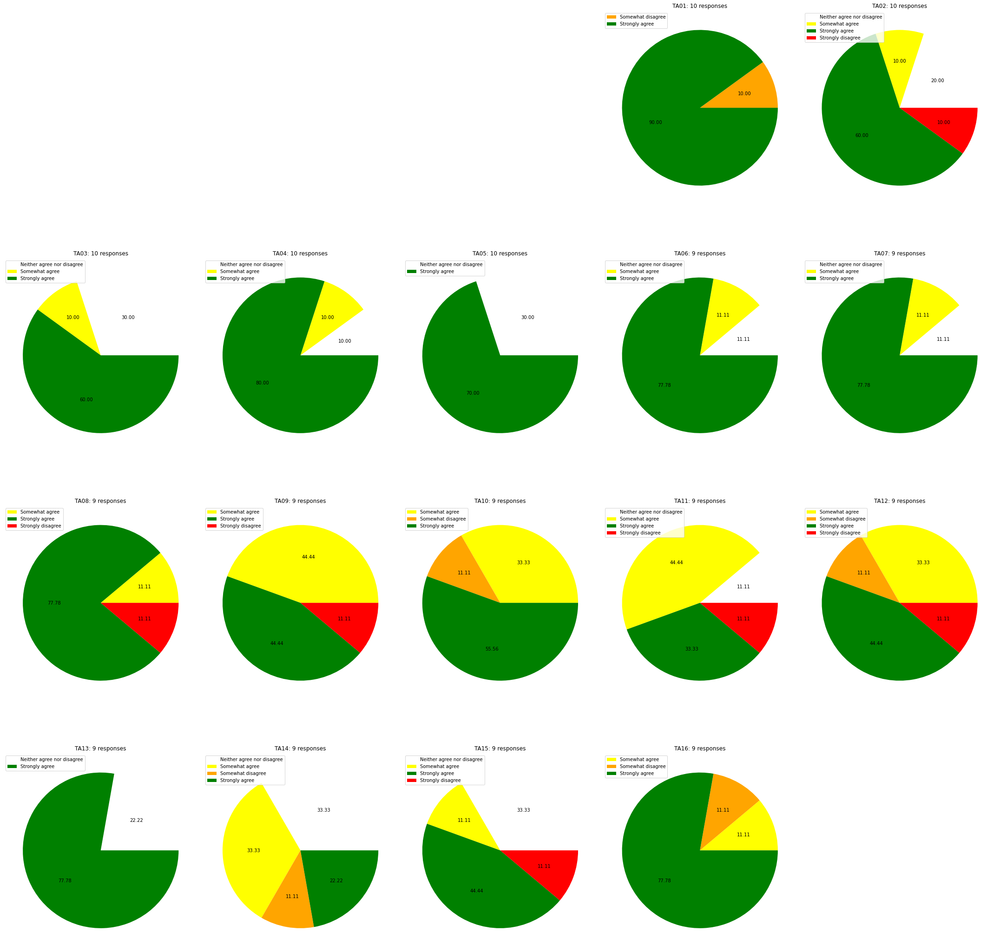

If given the opportunity, I would enroll in a class with the lab TA again.


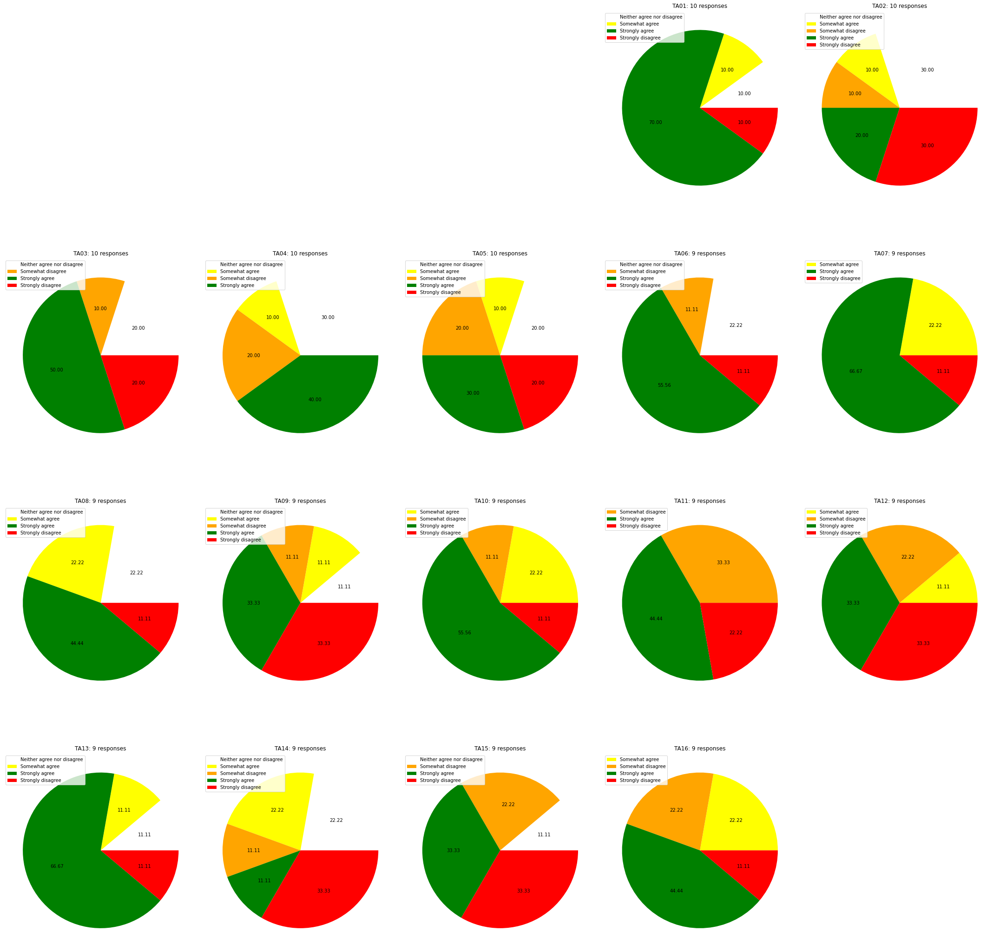

In [24]:
#For every question...
for i,q in enumerate(df.columns[1:-1]): 
    
    #Create a big figure
    plt.figure(figsize=(30,30))
    
    #Print the question
    print('\033[1m' + qs[q][0] + '\033[0m')
    
    #For every TA...
    for t,ta in enumerate(tas):
        
        #Create a dataframe with data just for that ta
        df = rawdata[rawdata['TA_first'] == ta]
        #Create a subplot in the big figure...
        plt.subplot(4,5,t+4)
        
        #Get shape of data
        x = df.shape[0]
        
        #Set slice sizes by % of responses
        sizes = df[q].value_counts().sort_index() / df[q].value_counts().sum() * 100
        
        #Set labels to string responses
        labels=sizes.index
        
        #Create pie plot
        plt.pie(sizes,autopct='%.2f',colors=[colors_dict[key] for key in labels]) #labels=sizes.index,
        
        #Set title (ta name and total number of responses)
        plt.title(f"{ta}: {x} responses")
        
        plt.legend(sizes.index,loc='upper left')
        
#     #Plot question on figure
#     plt.text(1.5,30, qs[q][0], transform = ax.transAxes,fontsize=25,fontweight = 'bold')
        
    #Save plot
    plt.savefig(output_folder / f'pie_{q}', pad_inches=0.3, transparent=False,
                dpi=300, bbox_inches='tight', facecolor='white')

    #Plot here as tight layout
    plt.tight_layout()
    #Show plot
    plt.show()
    

Now we make pie charts for each TA individually. A new figure is made for each TA, and each TA has a pie chart for each question representing the distribution of responses. These plots are useful for showing the results to TAs individually.

TA01


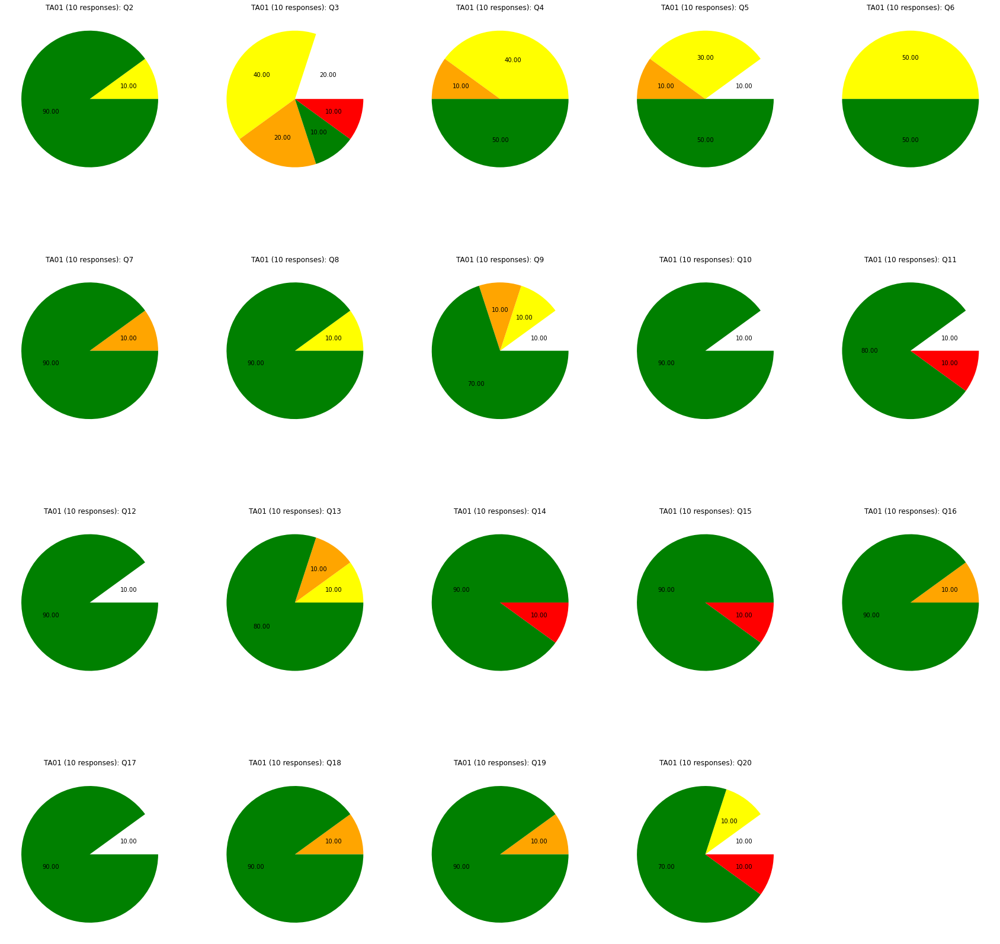

TA02


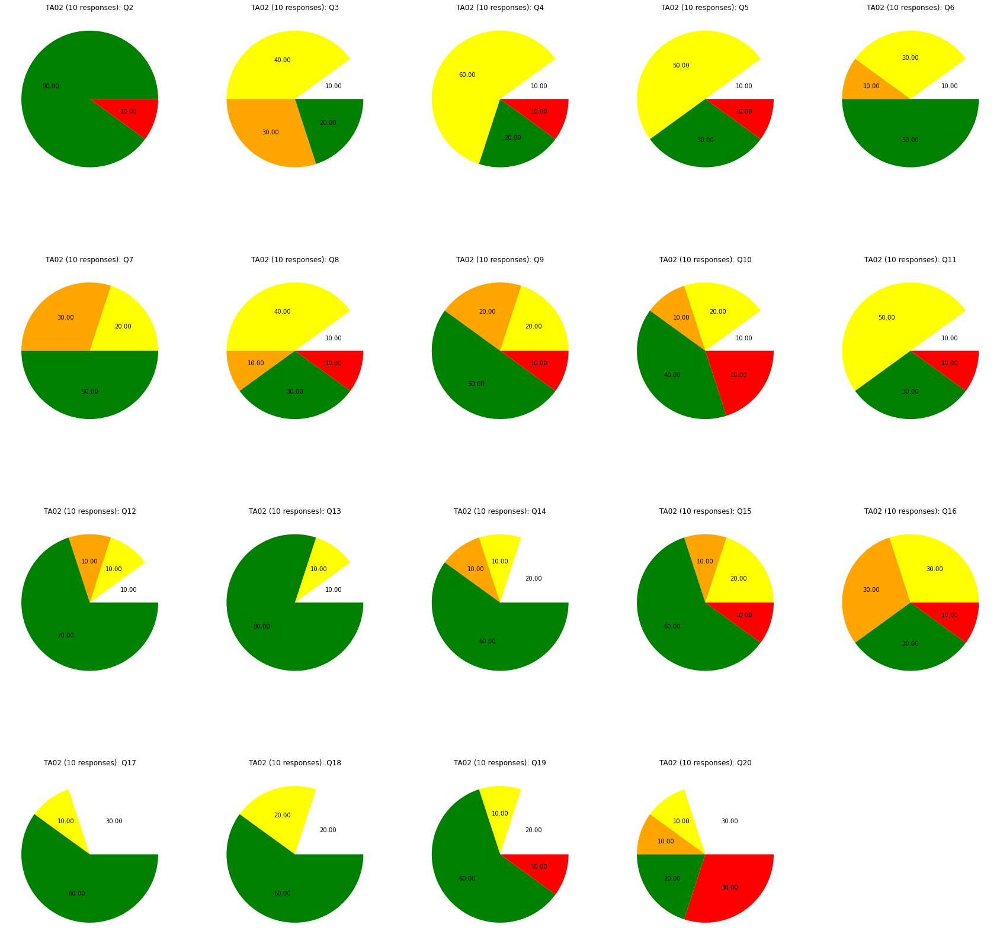

TA03


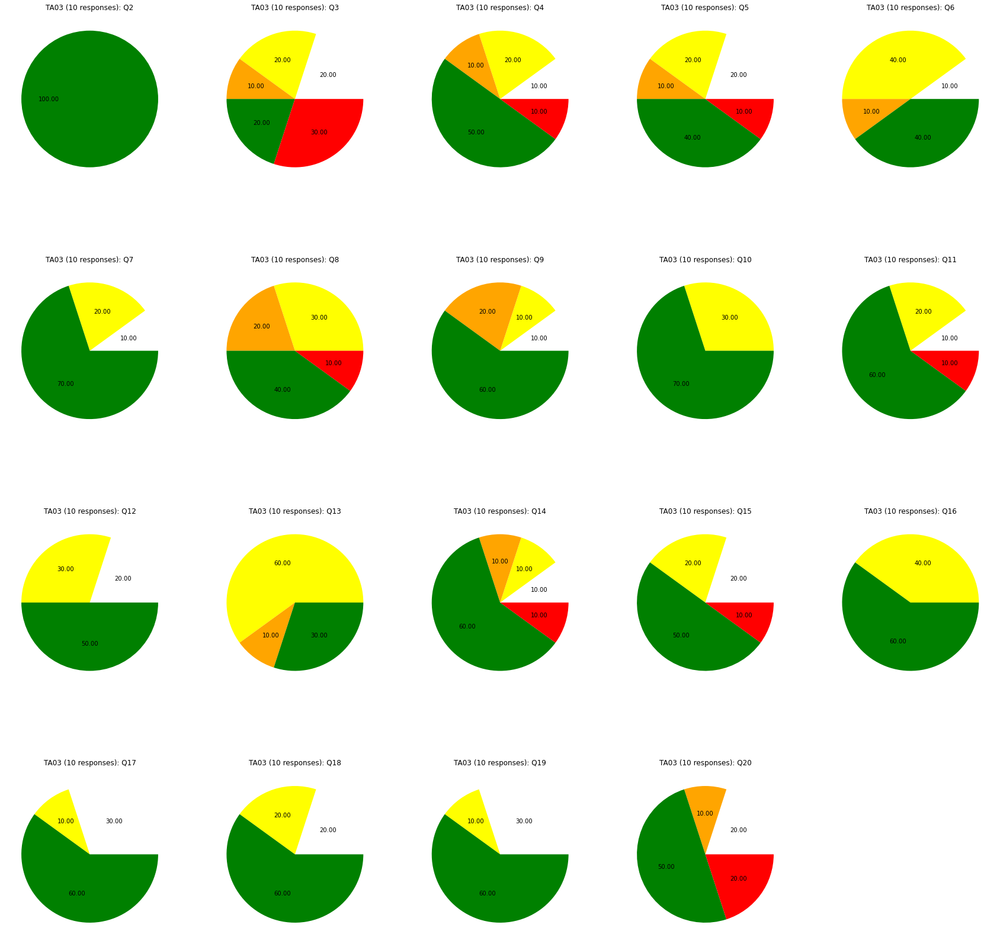

TA04


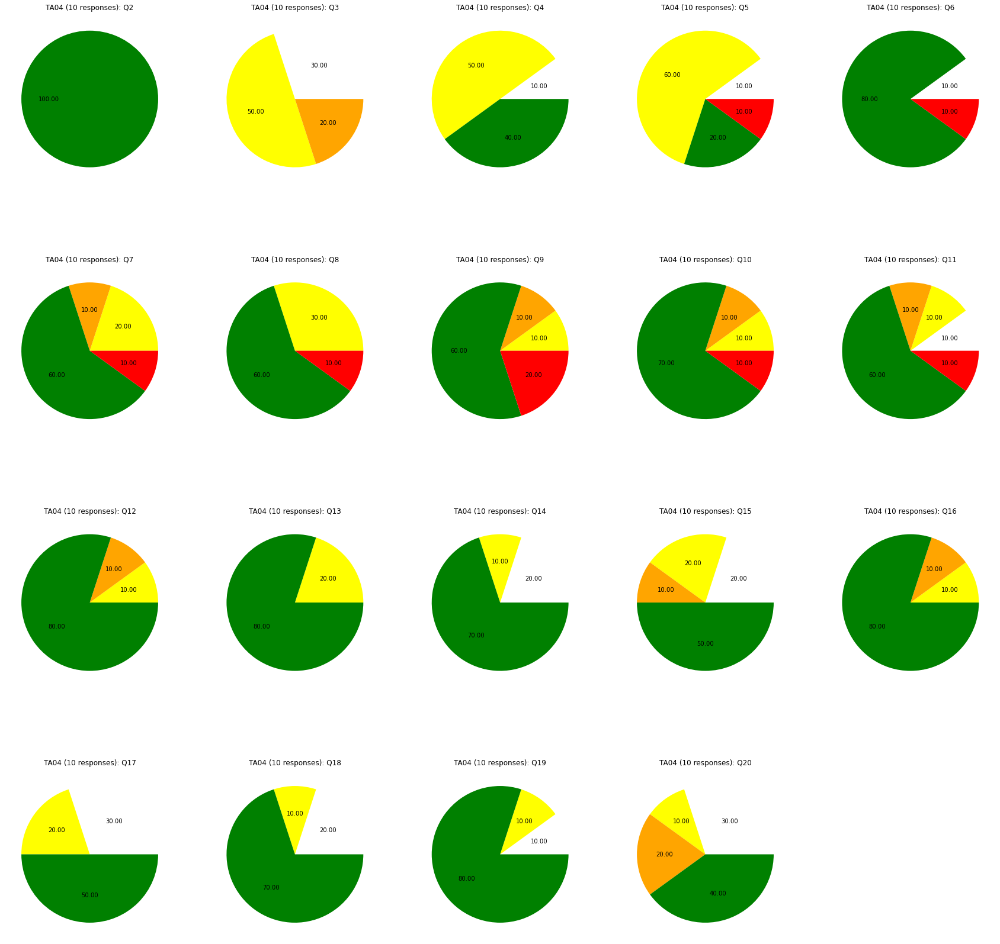

TA05


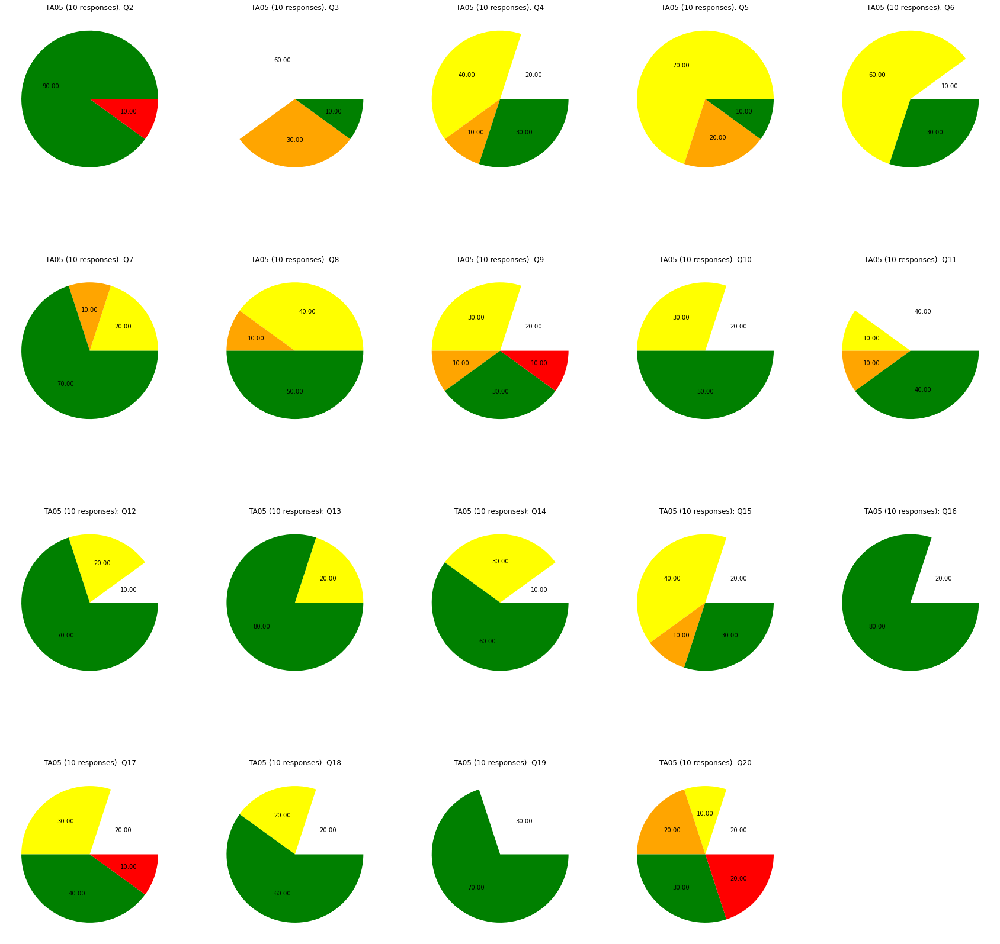

TA06


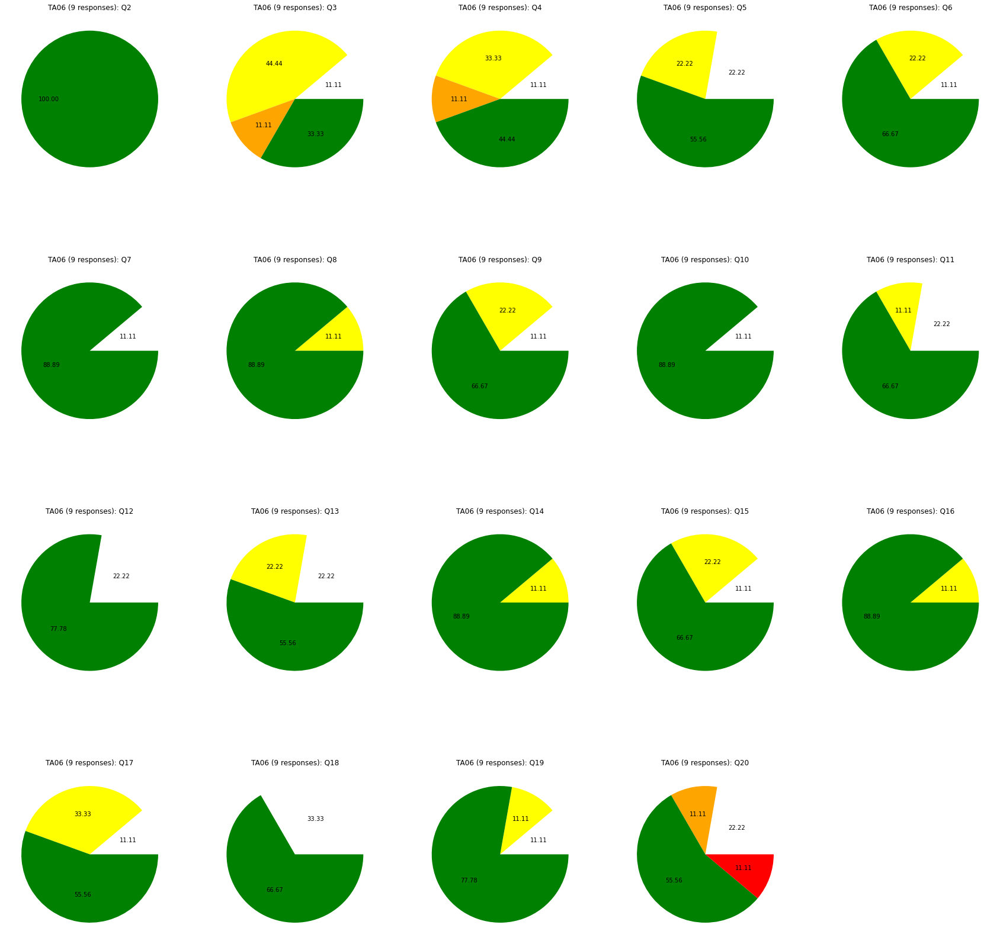

TA07


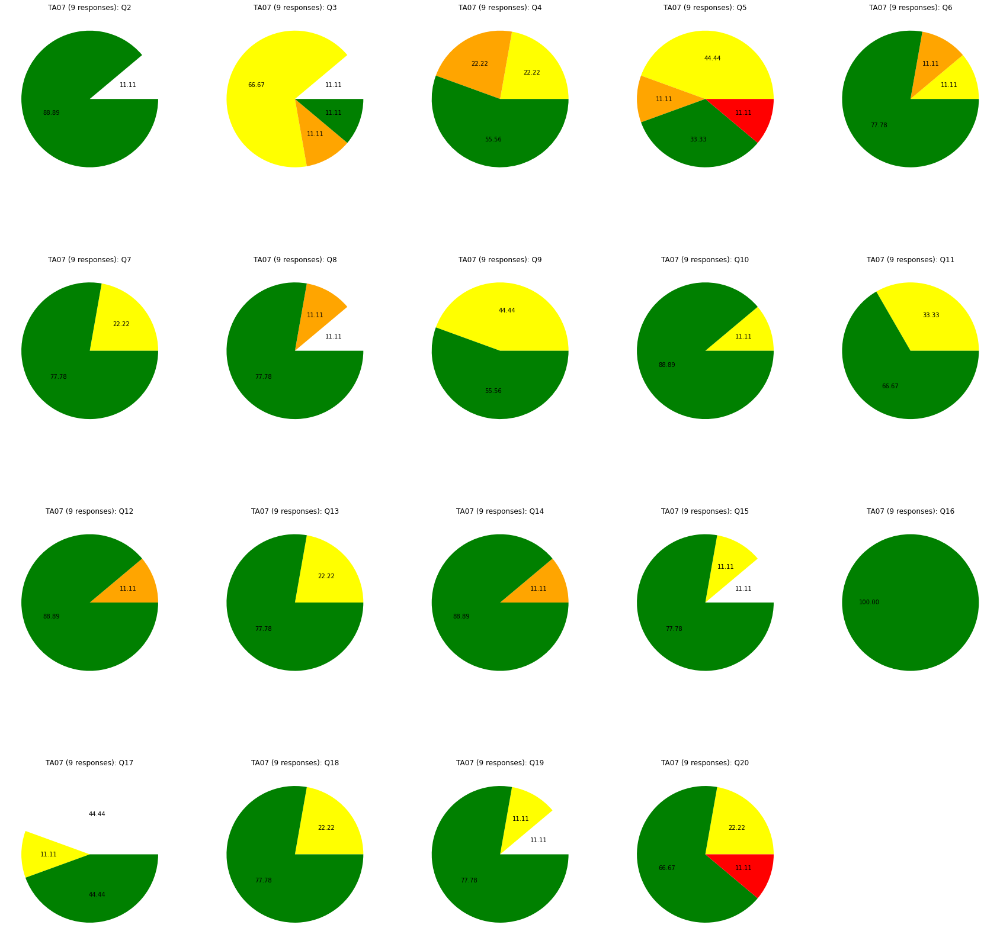

TA08


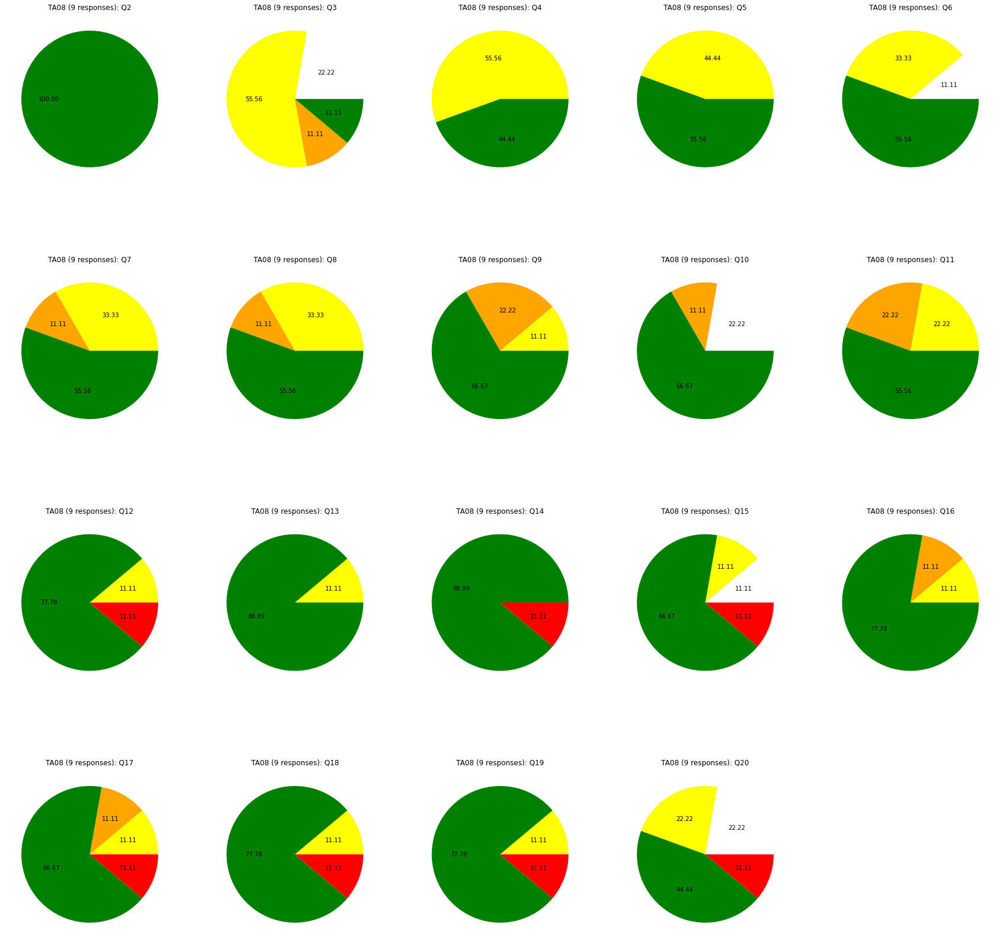

TA09


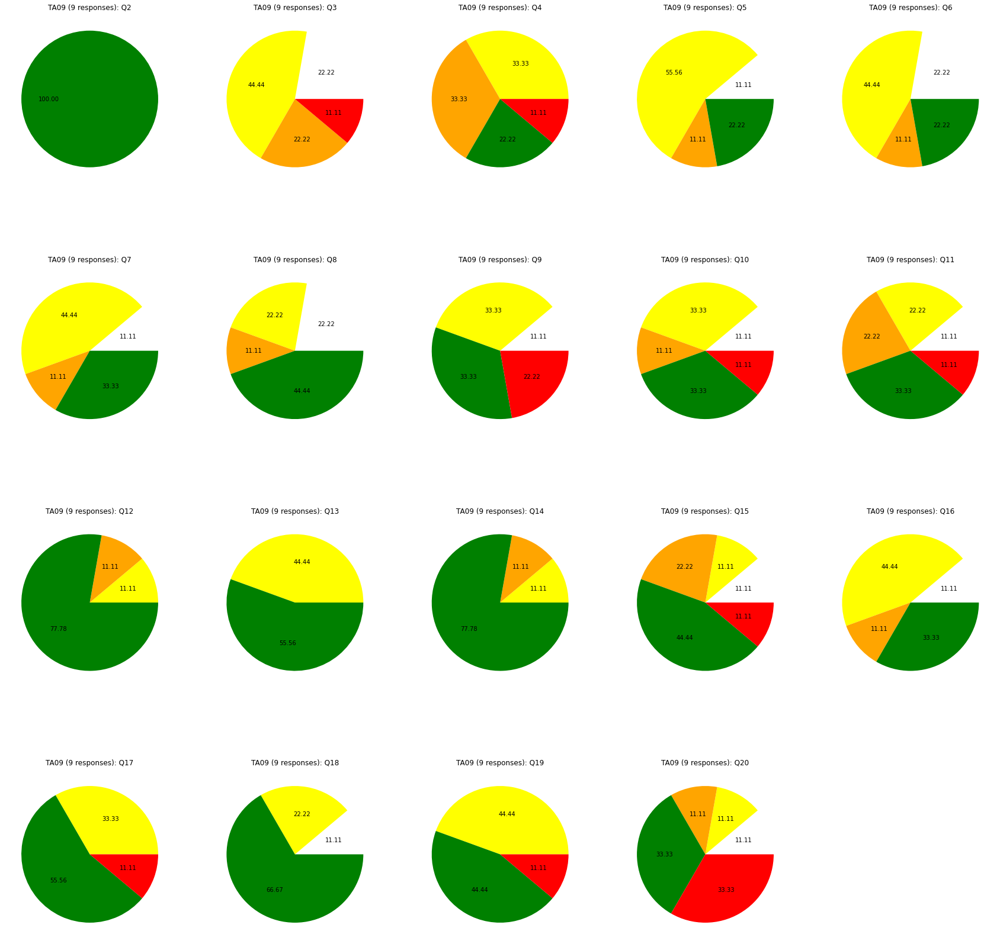

TA10


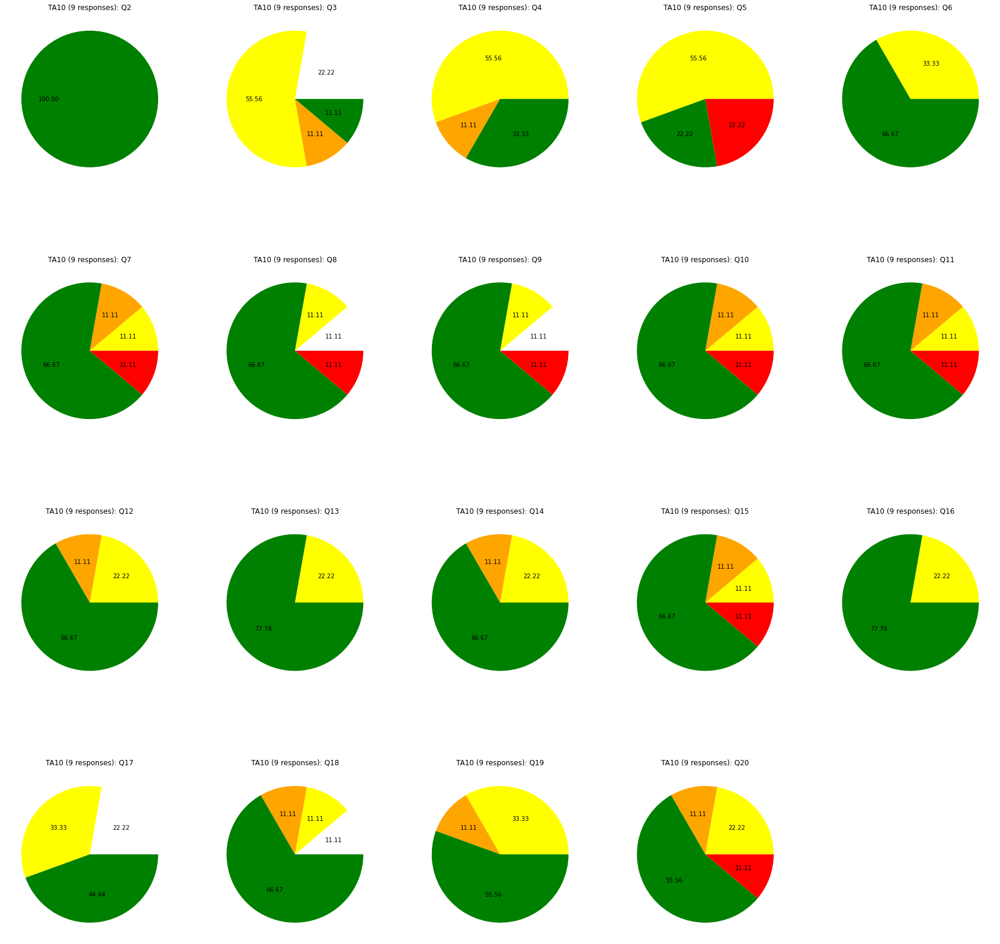

TA11


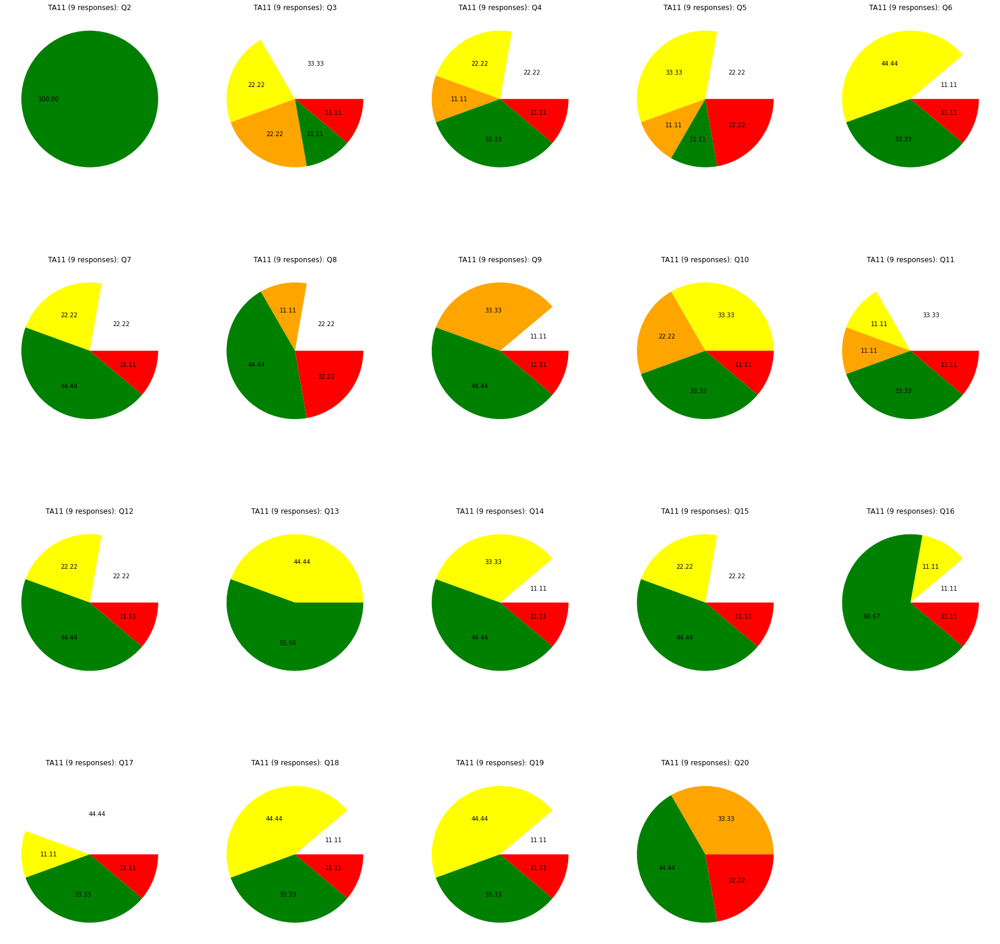

TA12


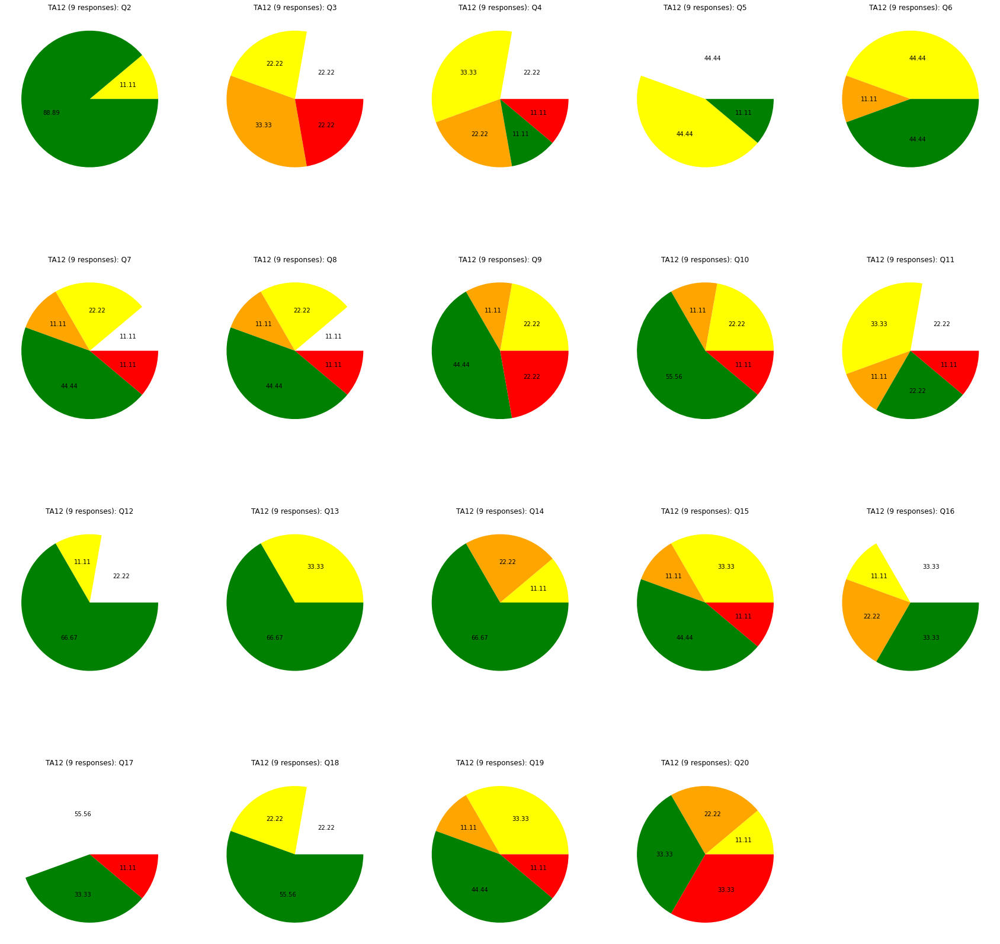

TA13


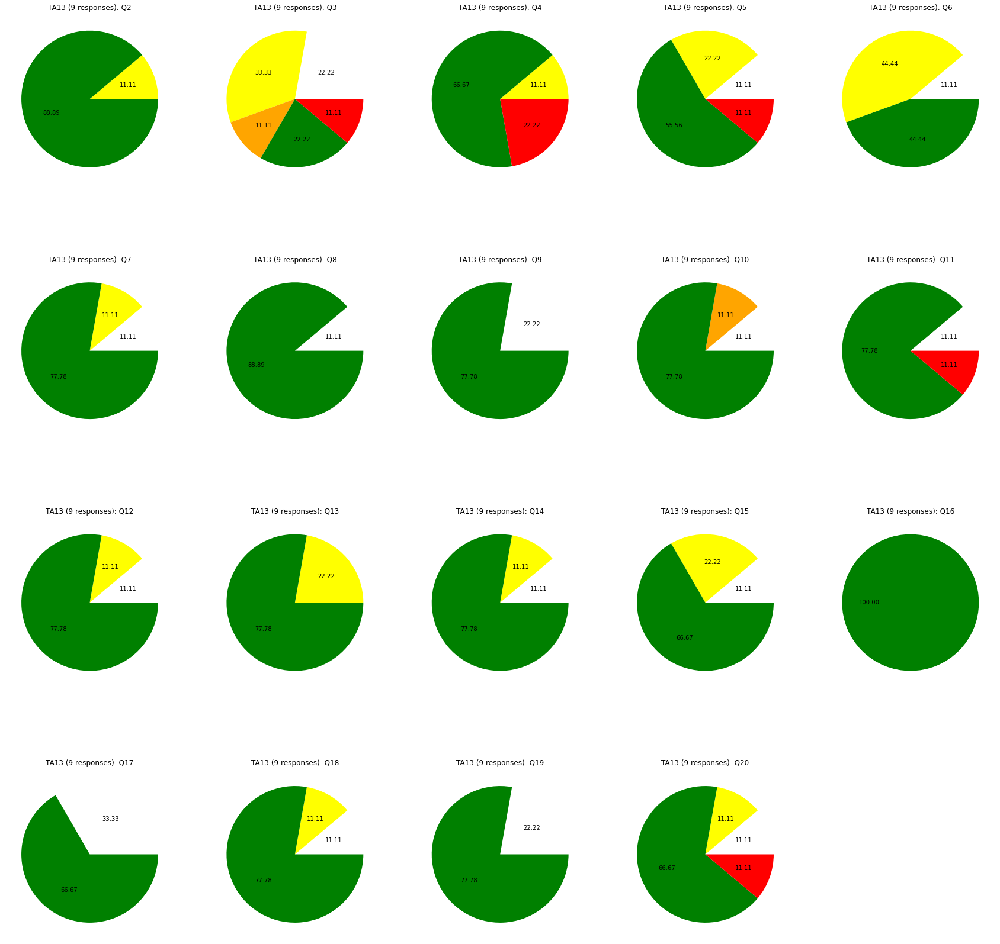

TA14


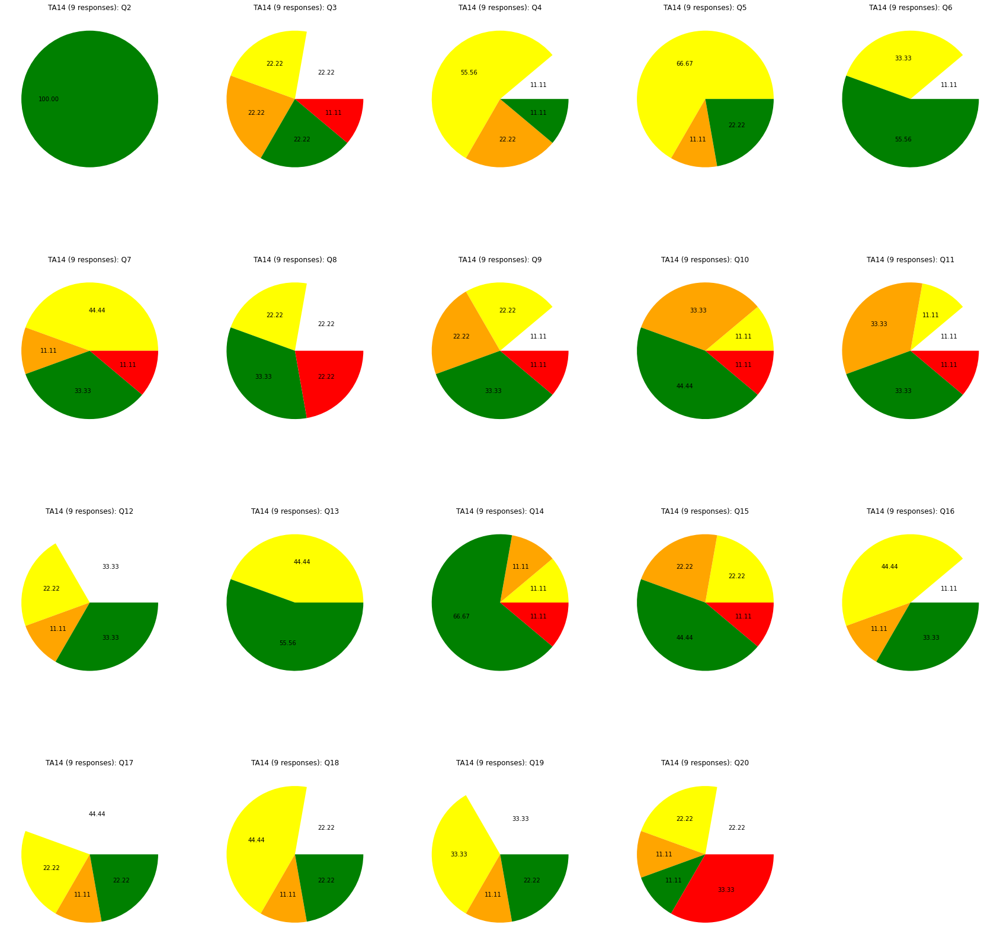

TA15


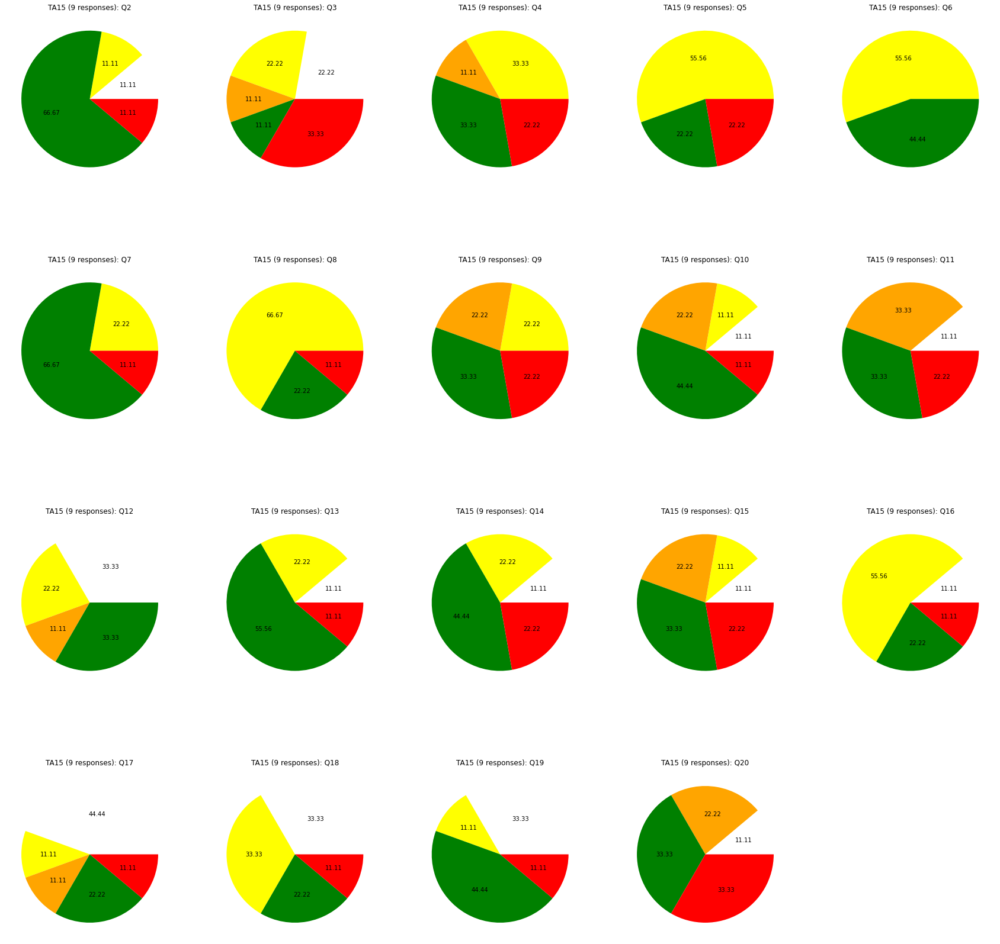

TA16


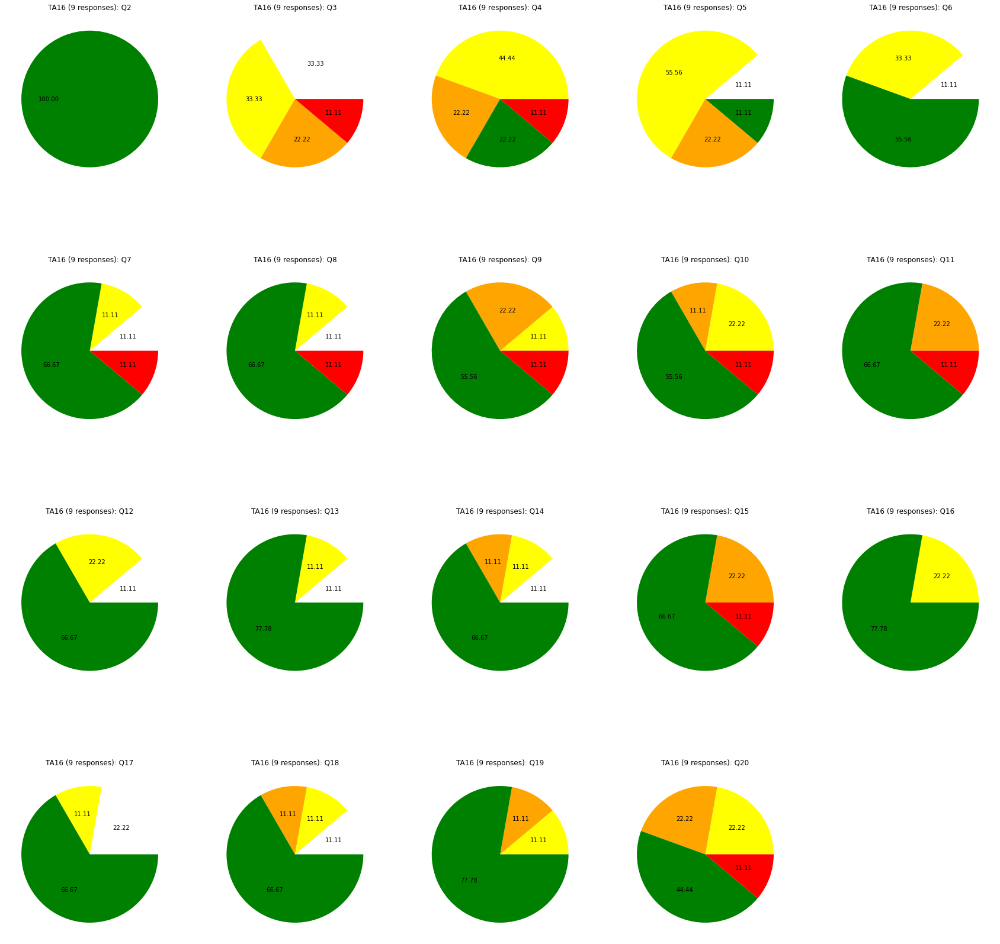

In [25]:
#Pie charts by TA
for t,ta in enumerate(tas):
    
    #Create figure
    plt.figure(figsize=(30,30))
    
    #Create df containing only rows with responses for an individual TA
    df = rawdata[rawdata['TA_first'] == ta]
#     plt.figure(figsize=(30,30))

    #Explicitly print TA name corresponsing to the plotted figure
    print('\033[1m' + ta + '\033[0m')
    
    #Get shape of data
    x = df.shape[0]

    #For each question...
    for i,q in enumerate(df.columns[1:-1]):   
        
        #Create 4x5 subplots and position them according to question number
        plt.subplot(4,5,i+1)
        
        #Slice sizes by percent
        sizes = df[q].value_counts().sort_index() / df[q].value_counts().sum() * 100
        
        #Retrieve written responses
        labels=sizes.index
        
        #Plot chart
        plt.pie(sizes,autopct='%.2f',colors=[colors_dict[key] for key in labels]) #labels=sizes.index
        plt.title(f'{ta} ({x} responses): {q}')
    
    #Save plot
    plt.savefig(output_folder / f'pie_{ta}', pad_inches=0.3, transparent=False,
                dpi=300, bbox_inches='tight', facecolor='white')
    
    #Show plot
    plt.show()

##### Line Graphs

Compares TA's response distribution to other TAs.

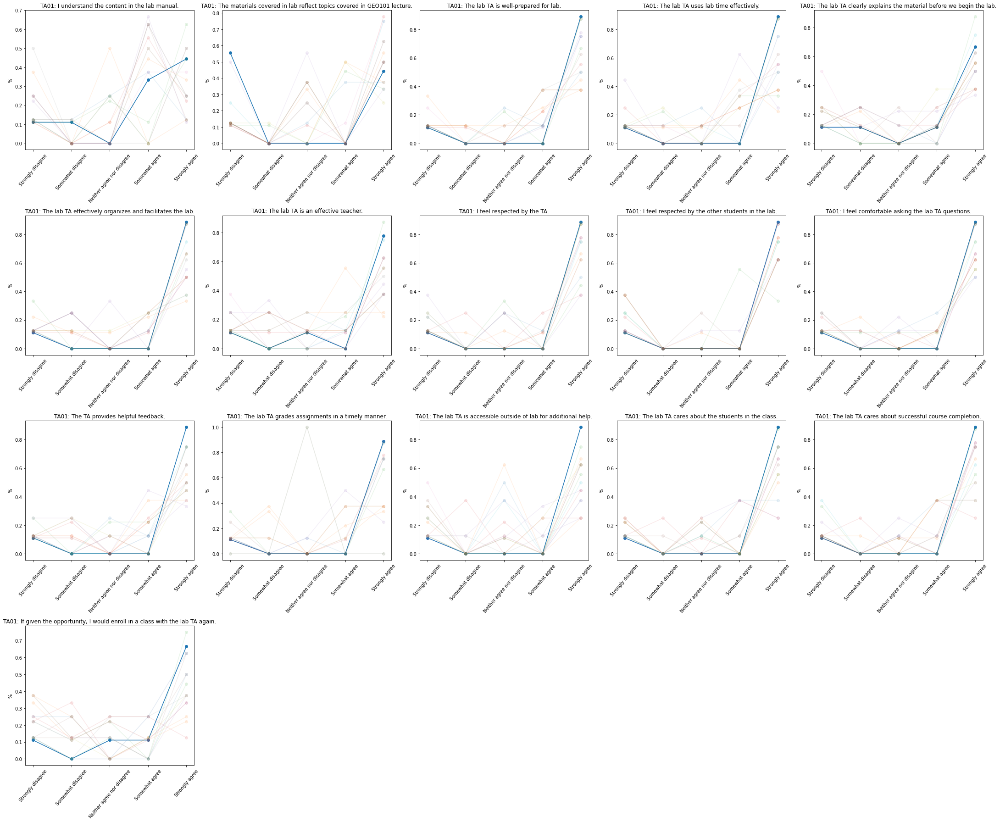

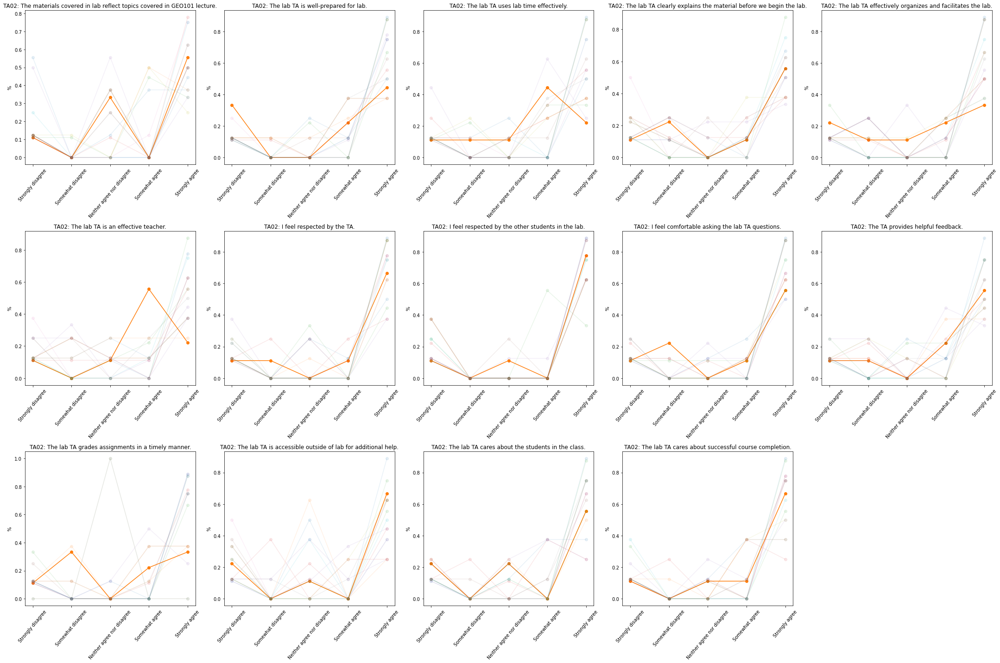

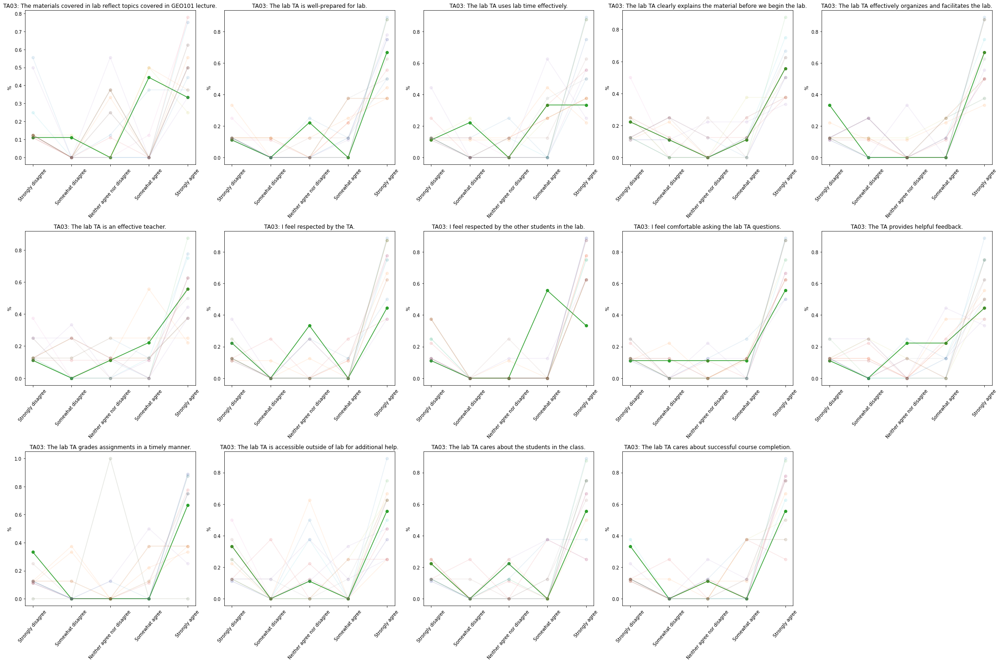

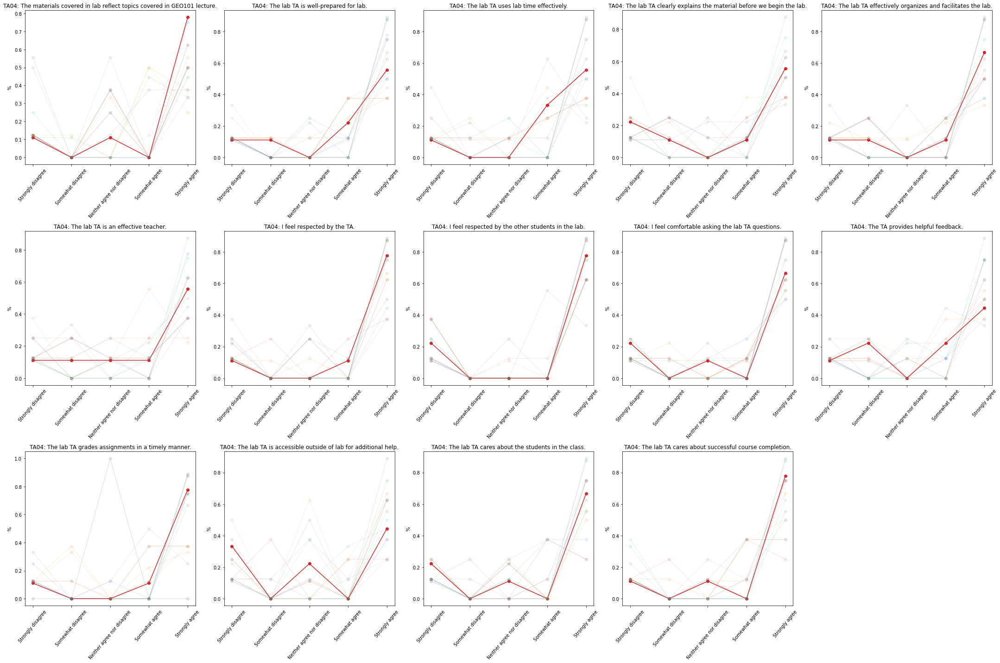

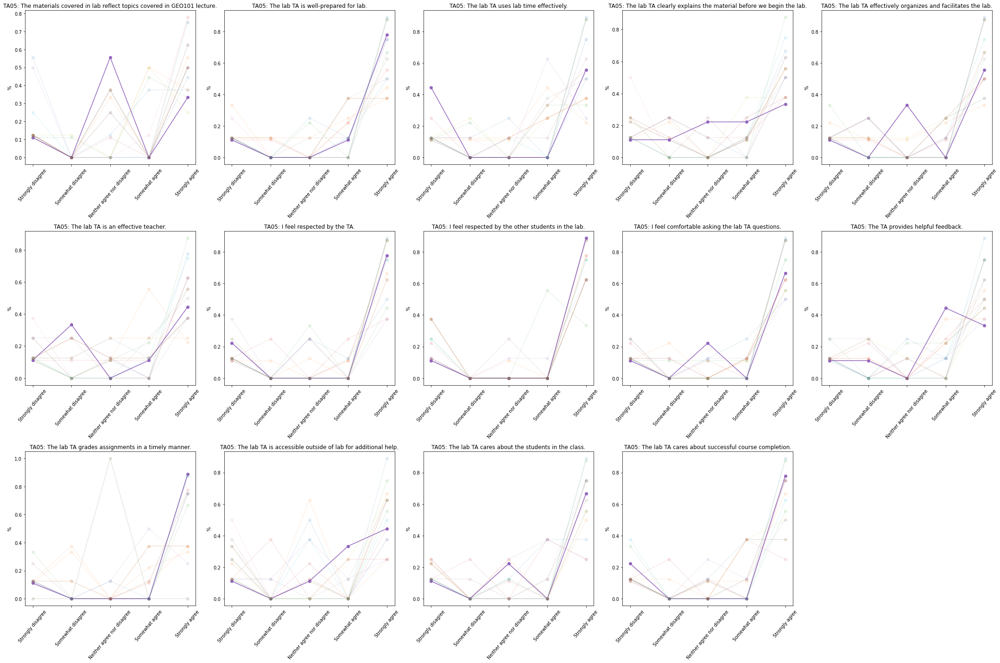

...

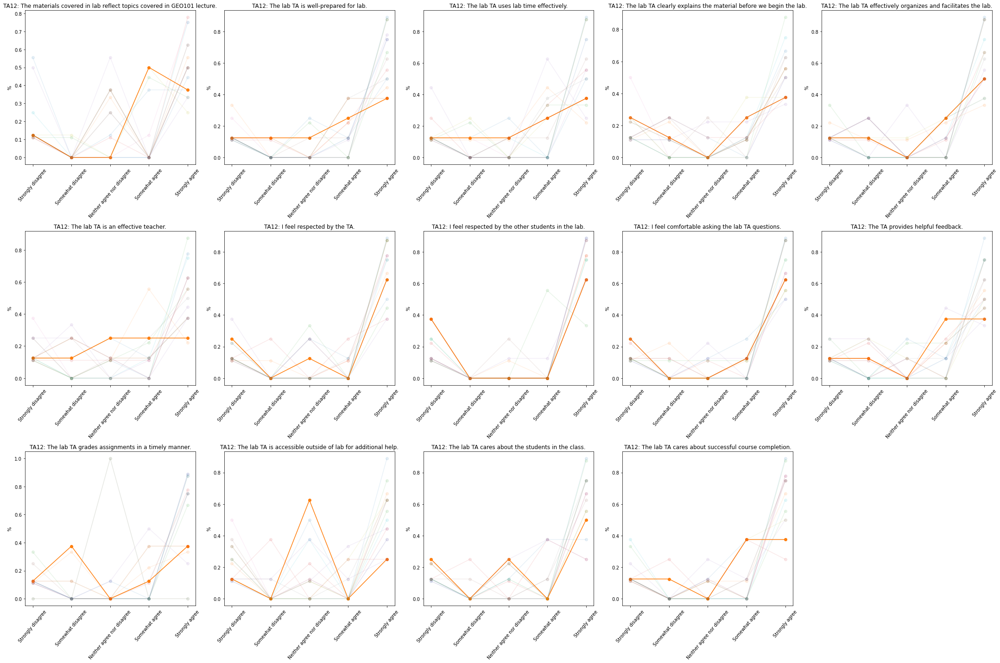

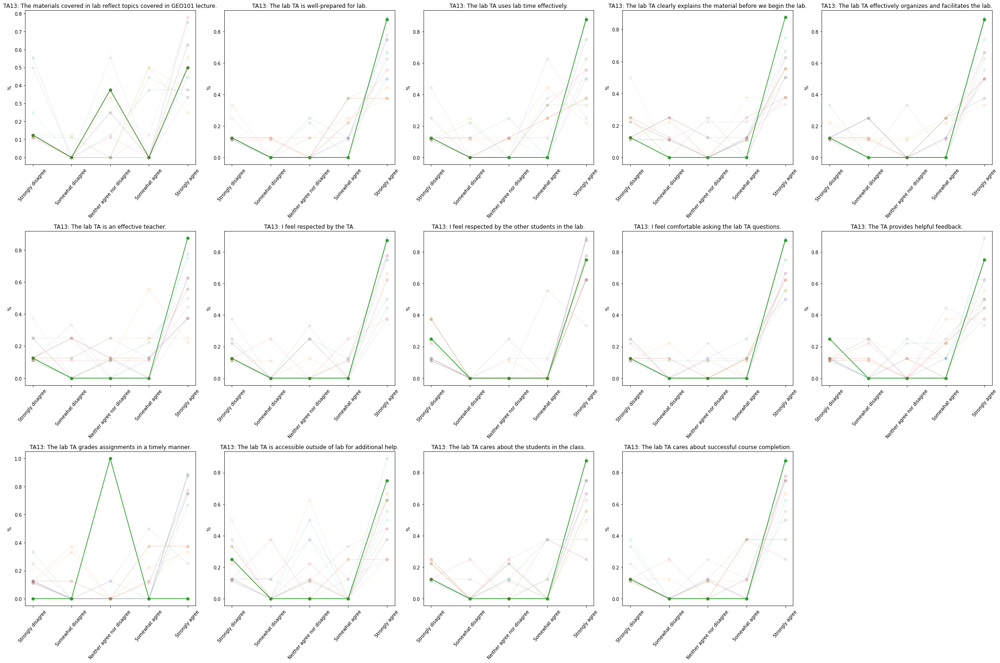

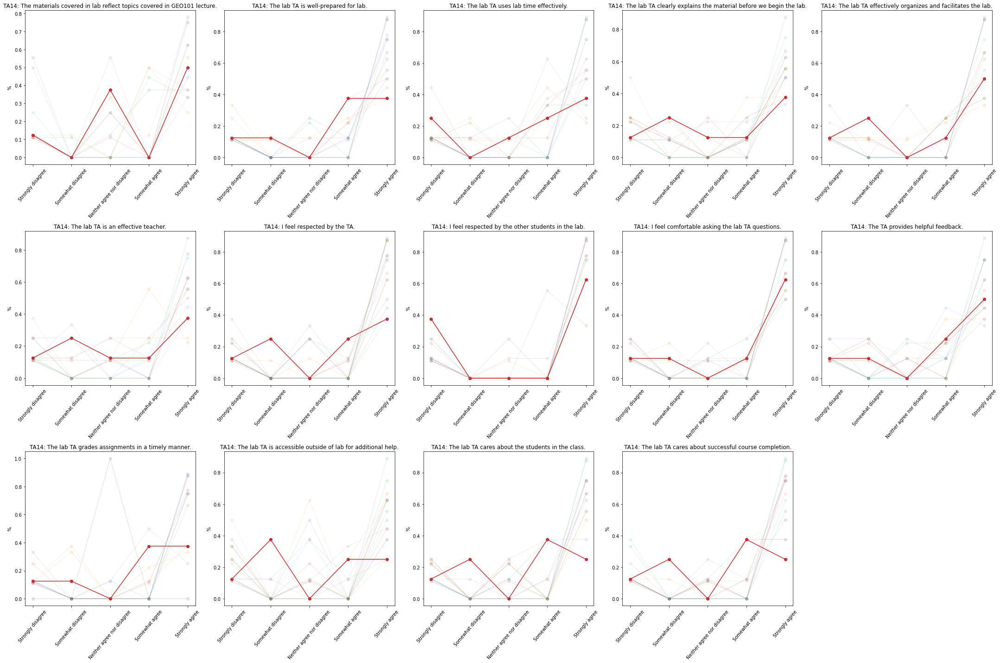

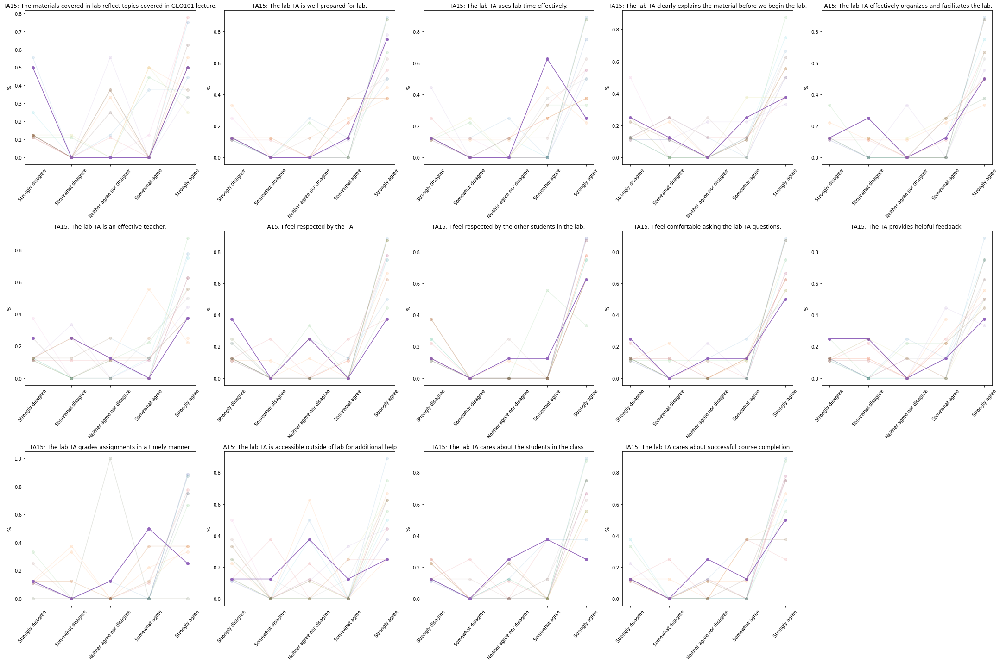

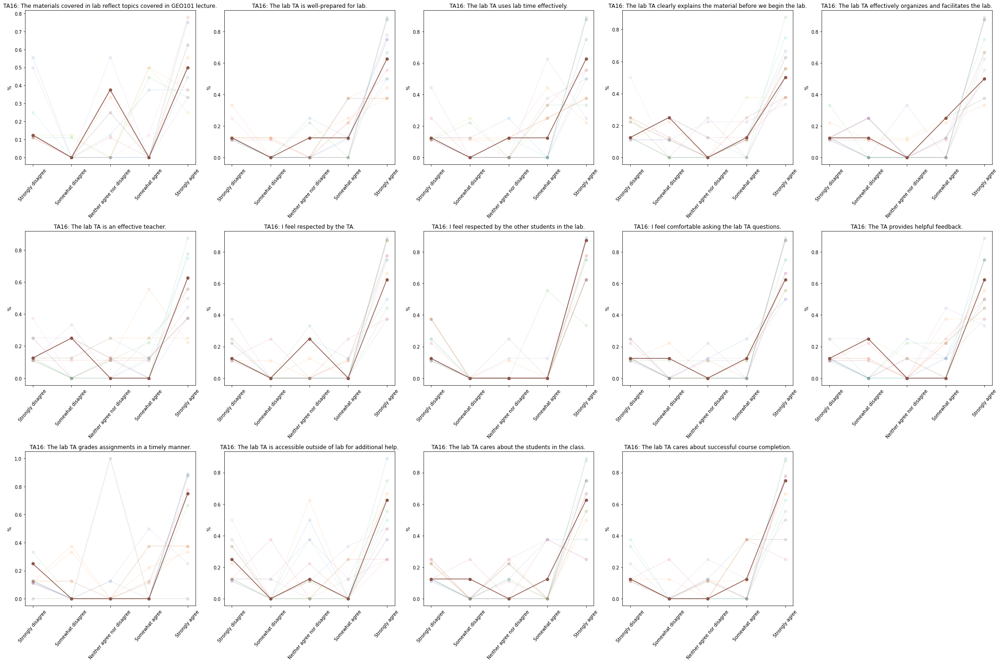

In [42]:
#For every ta...
for t2, ta2 in enumerate(tas):
    
    #Create a figure
    plt.figure(figsize=(30,25))   ###
    
    #For every question...
    for q,col in enumerate(df.columns[4:-1]):
        
        #Set color cycle
        ax.set_prop_cycle('color', [cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)])
        
        #For every ta...
        for t,ta in enumerate(tas):
            
            #Retrieve responses only for that TA
            df = data[data['TA_first']==ta]
            
            #Don't plot TA or TA_first columns
            df = df.iloc[1:,1:-1]
            
            #Position subplot according to question number
            plt.subplot(4,5,q+1) #Adjusts position

            #Get response counts
            vcounts, vbin_edges= np.histogram(df[col],bins=5,density = True)
            
            #Get response PDF
            vpdf = vcounts/sum(vcounts)
            
            #Get response CDF
            vcdf = np.cumsum(vpdf)
            
            #If plotting data for the ta...
            if ta2 == ta:
                
                #Highlight line for that TA
                plt.plot(num_answers,vpdf,marker='o',label=ta)
                
            #Otherwise...
            else:
                
                #Dampen line for other TAs
                plt.plot(num_answers,vpdf,marker='o',label=ta, alpha = 0.1)
                
        #Plot title by TA and question
        plt.title(f'{ta2}: {qs[col][0]}')
        #Set y label
        plt.ylabel("%")
        #Set x tick locations and labels
        plt.xticks(ticks=num_answers,labels=answers)
        #Rotate x tick labels
        plt.xticks(rotation=50)
    
    #Save plot
    plt.savefig(output_folder / f'line_{ta2}', pad_inches=0.3, transparent=False,
                dpi=300, facecolor='white')
    
    #Show plot
    plt.tight_layout()
    plt.show()

##### Essay Questions

There's no real way to categorize essay responses, so here they are just printed and you have to read them manually. Sorry.

In [61]:
#Define columns corresponding to essay questions
essay_qs = ['Q21','Q23']

#Load in data for the essay question columns
essays = pd.read_csv(survey_file,usecols=essay_qs)

#Add TA_first column to essays df
essays['TA_first'] = data['TA_first']

essay_questions = [essays.iloc[0][0],essays.iloc[0][1]]

# Ignore row of questions and metadata
essays = essays.iloc[2:,:]

In [82]:
#For every TA...
for ta in tas:
    
    #Print the TA's name
    print('\033[1m' + ta + '\033[0m')
    
    for i in [0,1]:
        
        print('\033[1m' + essay_questions[i] + '\033[0m')
    
        #And for every essay question response for that TA...
        for x in essays[essays['TA_first']==ta][essay_qs[i]]:

            #Print the response
            print(x)
        
    #Separate TAs and reponses by printing new line
    print('\n')

TA01
In your opinion, how can this lab experience be improved?
nan
I think it is well planned out and very organized.
I wish the TA would be understanding when I or other classmates had trouble understanding the assignment. It is like as if we are expected to be experts in this lab. 
I love my TA, no improvement 
nan
I feel like the lab manual is difficult to understand. Some questions aren’t well written. Recently, on the field trip lab, the HW felt like it didn’t match up with the article whatsoever. It was difficult to find the answers.
Having the labs on mondays is not good, because then we are typically doing the labs before we learn the material in class that week. 
Shorter labs
Remove the lab quizzes please. 
nan
Please leave any additional comments below.
nan
nan
In our lab, our TA has us work in groups to complete our assignments. However, when our assignments are graded, we all end up with different grades than the others which in my opinion makes no sense because we worked t